In [1]:
#Import necessary libraries - should work mostly from BCI_analysis + matplotlib + numpy
import BCI_analysis
from BCI_analysis.pipeline import pipeline_regression
import importlib
importlib.reload(pipeline_regression)
importlib.reload(BCI_analysis)
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from datetime import datetime
import scipy

No module named 'cellpose'
cannot use anatomical mode, but otherwise suite2p will run normally


In [2]:
# using data from .mat file 
from oasis.functions import deconvolve
importlib.reload(BCI_analysis)

mat_file_dir = "/home/jupyter/bucket/Data/Calcium_imaging/multi_session_mat/"
dlc_base_dir = os.path.abspath("/home/jupyter/bucket/Data/Behavior_videos/DLC_output/Bergamo-2P-Photostim/")
bpod_path = os.path.abspath("/home/jupyter/bucket/Data/Behavior/BCI_exported/Bergamo-2P-Photostim/")
suite2p_path = os.path.abspath("/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/")
sessionwise_data_path = os.path.abspath("/home/jupyter/bucket/Data/Calcium_imaging/sessionwise_tba/")

plt_save_path = os.path.abspath("/home/jupyter/Plots/")
face_rhythm_base_dir = '/home/jupyter/bucket/Data/Behavior_videos/FaceRhythm/'
motion_energy_base_dir = os.path.abspath("/home/jupyter/bucket/Data/Behavior_videos/MotionEnergy/Bergamo-2P-Photostim/")
raw_video_path = os.path.abspath("/home/jupyter/bucket/Data/Behavior_videos/raw/Bergamo-2P-Photostim/")

multi_session_dict = {'mouse':[],
                     'session':[],
                      'mat_idx':[],
                     'cn':[],
                     'DLC_aligned':[],
                     'F':[],
                     'trial_end_frames':[],
                     'F_original':[],
                     'trial_start_original':[],
                     'reward_original':[]}
#needed_subject = 'BCI34'
sessions_with_errors = [] # sessions that are skipped collected in this list
no_cn_sessions = []
invalid_neurons = [] # with inf
blacklist = ['data_behav_BCI29_051122.mat',#only 18 trials
             'data_behav_BCI29_052422.mat', # no CN
             'data_behav_BCI30_050322.mat',# no CN
             'data_behav_BCI34_070722.mat',# no CN
             'data_behav_BCI31_051222.mat',#only 3 trials
             'data_behav_BCI35_063022.mat',# no CN
             'data_behav_BCI39_070522.mat', #no cn
             'data_behav_BCI29_042122.mat',# no video?
             # 'data_behav_BCI29_061022.mat',#next sessions CN is missing
             # 'data_behav_BCI29_050622.mat',#next sessions CN is missing
             # #'050422'
             #'data_behav_BCI29_051322_2.mat',# error during this extraction
             'data_behav_BCI29_051722.mat',# no video?
             'data_behav_BCI29_052022.mat',# no video?
             'data_behav_BCI31_051822.mat',# no video?
             'data_behav_BCI31_051922.mat',# no video?
             'data_behav_BCI31_052022.mat',# no video?
             'data_behav_BCI31_052422.mat',# no video?
             'data_behav_BCI31_052522.mat',# no video?
             'data_behav_BCI29_051322_2.mat',# no video?
             'data_behav_BCI38_071322.mat',# no video?
             'data_behav_BCI38_071422.mat',# no video?
             'data_behav_BCI38_071822.mat',# no video?
             'data_behav_BCI38_071922.mat',# no video?
            ]

do_deconvolve = False ## for calcium 
convolve_movement_data = True
convolve_tau = 0.7
keep_post_reward = True

foldername_ = 'data_aligned'
if convolve_movement_data:
    foldername_ += '_convolved'
else:
    convolve_tau = 0
    
if keep_post_reward:
    foldername_ += '_with_reward'
if do_deconvolve:
    foldername_ += '_deconvolved'
aligned_data_path = os.path.abspath("/home/jupyter/bucket/Data/Calcium_imaging/" + foldername_)
if not os.path.exists(aligned_data_path):
    os.makedirs(aligned_data_path)
# if convolve_movement_data:
#     if keep_post_reward:
#         aligned_data_path = os.path.abspath("/home/jupyter/bucket/Data/Calcium_imaging/data_aligned_convolved_with_reward/")
#     else:
#         aligned_data_path = os.path.abspath("/home/jupyter/bucket/Data/Calcium_imaging/data_aligned_convolved/")
# else:
#     if keep_post_reward:
#         aligned_data_path = os.path.abspath("/home/jupyter/bucket/Data/Calcium_imaging/data_aligned_with_reward/")
#     else:
#         aligned_data_path = os.path.abspath("/home/jupyter/bucket/Data/Calcium_imaging/data_aligned/")
    
mat_files_ = os.listdir(mat_file_dir)
mat_files = []
session_dates = {}
kept_files = []
files_thrown_away = []
for f in mat_files_:
    if f.startswith('data_behav'):
        if f in blacklist:
            print('{} blacklisted, removed'.format(f))
            files_thrown_away.append(f)
            continue
        mat_files.append(f)
        subject = f[11:16]
        session = f[17:23]
        if subject not in session_dates.keys():
            session_dates[subject] = {}
        session_dates[subject][datetime.strptime(session,'%m%d%y')]  = [session,f]
        kept_files.append(f)
for mouse in session_dates.keys():
    for session_date in np.sort(list(session_dates[mouse].keys())):
        session,filename = session_dates[mouse][session_date]
        data_raw = scipy.io.loadmat(os.path.join(mat_file_dir,filename))
        # check basic stuff
        if data_raw['session'][0] != session:
            print('invalid session!! {} vs {}, using the latter'.format(data_raw['session'][0], session))
        try:
            data_raw['conditioned_neuron'][0][0]
        except:
            print('no cn for {}, skipping'.format(filename))
            no_cn_sessions.append(filename)
            continue
#         if any(np.isinf(data_raw['df_closedLoop']).flatten()):
#             print('invalid neuron in {}, skipped'.format(filename))
#             invalid_neurons.append(filename)
            
#             continue
           # asd
        #mouse  = mouse[:3]+'_'+mouse[3:]
        camera = "side"
        data = {'F':data_raw['df_closedLoop'].T,
               'trial_start':data_raw['trial_start'][0],
               'reward':data_raw['rew'][0],
               'cn':int(data_raw['conditioned_neuron'][0][0])-1,
               'si':data_raw['dt_si'][0][0]}
        #asdsa

        if do_deconvolve:
            spikes_matrix= []
            for F_trace in data['F']:
                try:
                    c, s, b_, g_, lam = deconvolve(F_trace, penalty=1) 
                except:
                    s = np.zeros(len(F_trace))
                    print('could not deconvolve')
                spikes_matrix.append(s)
            data['F'] = np.asarray(spikes_matrix)

       # try:
        dict_aligned = BCI_analysis.pipeline_align.get_aligned_data(suite2p_path, 
                                                                    dlc_base_dir, 
                                                                    bpod_path, 
                                                                    sessionwise_data_path, 
                                                                    aligned_data_path, 
                                                                    motion_energy_base_dir,
                                                                    raw_video_path,
                                                                    mouse=mouse[:3]+'_'+mouse[3:], 
                                                                    FOV=None, 
                                                                    camera=camera, 
                                                                    session=session, 
                                                                    sampling='down', 
                                                                    functions = ['diff','diff_signed','mean'],
                                                                    function_window = 20,  ### important variable for downsampling 1 for facerhythm - 20/200 for DLC
                                                                    convolve_tau = convolve_tau,#,0.7, #.7
                                                                    plot = False,
                                                                    overwrite=False,
                                                                    use_provided_data=True,
                                                                    add_motion_energy = False,
                                                                    source_data = data,
                                                                    face_rhythm_base_dir = face_rhythm_base_dir,
                                                                    use_face_rhythm = False,
                                                                    match_with_face_rhythm = False,
                                                                    only_up_to_reward = not keep_post_reward)
        if 'trial_start_indices' not in dict_aligned.keys():
            dict_aligned = BCI_analysis.pipeline_align.get_aligned_data(suite2p_path, 
                                                                    dlc_base_dir, 
                                                                    bpod_path, 
                                                                    sessionwise_data_path, 
                                                                    aligned_data_path, 
                                                                    motion_energy_base_dir,
                                                                    raw_video_path,
                                                                    mouse=mouse[:3]+'_'+mouse[3:], 
                                                                    FOV=None, 
                                                                    camera=camera, 
                                                                    session=session, 
                                                                    sampling='down', 
                                                                    functions = ['diff','diff_signed','mean'],
                                                                    function_window = 20,  ### important variable for downsampling 1 for facerhythm - 20/200 for DLC
                                                                    convolve_tau = convolve_tau,#,0.7, #.7
                                                                    plot = False,
                                                                    overwrite=True,
                                                                    use_provided_data=True,
                                                                    add_motion_energy = False,
                                                                    source_data = data,
                                                                    face_rhythm_base_dir = face_rhythm_base_dir,
                                                                    use_face_rhythm = False,
                                                                    match_with_face_rhythm = False,
                                                                    only_up_to_reward = not keep_post_reward)
            
        print('data aligned for {}'.format(f))
        # try:
        DLC_aligned = pd.DataFrame.from_dict(dict_aligned['DLC_aligned'])
        F = np.concatenate(dict_aligned['F_aligned'], axis=1)

        multi_session_dict['mouse'].append(mouse)
        multi_session_dict['session'].append(session)
        multi_session_dict['cn'].append(data['cn'])
        multi_session_dict['mat_idx'].append(None)
        multi_session_dict['DLC_aligned'].append(DLC_aligned)
        multi_session_dict['F'].append(F)
        multi_session_dict['trial_end_frames'].append(dict_aligned['trial_start_indices'])
        multi_session_dict['F_original'].append(data['F'])
        multi_session_dict['trial_start_original'].append(data['trial_start'])
        multi_session_dict['reward_original'].append(data['reward'])
        # except:
        #     sessions_with_errors.append(filename)
        #     print('could not add session {} - skipping - check for matching sessions!!'.format(session))
        



/home/jupyter/Scripts/OASIS/oasis/functions.py:13: UserWarning: Could not find cvxpy. Don't worry, you can still use OASIS, just not the slower interior point methods we compared to in the papers.
  warn("Could not find cvxpy. Don't worry, you can still use OASIS, " +


FileNotFoundError: [Errno 2] No such file or directory: '/home/jupyter/bucket/Data/Calcium_imaging/multi_session_mat/'

In [5]:
dict_aligned.keys()

dict_keys(['F_aligned', 'DLC_aligned', 'dff_aligned', 'lick_times_aligned', 'reward_times_aligned', 'trial_times_aligned', 'cn', 'trials_taken', 'trial_start_indices'])

In [30]:
pair_num = 0
mouse_now = ''
mouse_idx = 0
pair_num_per_mouse = []
mouse_list = []
for da,mouse in zip(multi_session_dict['delta_amplitude'],multi_session_dict['mouse']):
    if mouse_now!=mouse:
        mouse_now = mouse
        pair_num_per_mouse.append(0)
        mouse_list.append(mouse_now)
        
    if da != []:
        pair_num +=1
        pair_num_per_mouse[-1]+=1



/tmp/ipykernel_3737/368007207.py:12: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if da != []:


In [34]:
len(multi_session_dict['p_increase'])

8

In [48]:
multi_session_dict['F_original'][session_i-1].shape

(628, 30231)

In [47]:
multi_session_dict['F_original'][session_i].shape

(381, 28924)

In [3]:
# bootstrapping of amplitudes 
#
from sklearn.utils import resample
plot_amplitudes = False
max_p = .01
n_bootstrap = 1000
step_back = 40 #baseline before trial start (in frames)
step_forward = 200 #integration time after trial start (frames)

reward_step_back = 20 #baseline before trial start (in frames)
reward_step_forward = 100 #integration time after trial start (frames)

trace_time = np.arange(-step_back,step_forward)/20
# check if CNs are really increasing it's activity - who are the other cells that increase their activity
multi_session_dict['F_trialwise'] = [] #time x neuron x trial
multi_session_dict['F_rewardwise'] = [] #time x neuron x trial
multi_session_dict['amplitude'] = []
multi_session_dict['previous_amplitude'] = []
multi_session_dict['reward_amplitude'] = []
multi_session_dict['previous_reward_amplitude'] = []
multi_session_dict['delta_amplitude'] = []
multi_session_dict['p_increase'] = []
multi_session_dict['p_decrease'] = []

for session_i,session in enumerate(multi_session_dict['session']):
    # trial_start_trace = np.zeros(multi_session_dict['F'][session_i].shape[1])
    # trial_start_trace[np.concatenate([[0],multi_session_dict['trial_end_frames'][session_i][:-1]])] = 1
    trial_start_trace = multi_session_dict['trial_start_original'][session_i]
    F_trialwise = BCI_analysis.io_suite2p.sessionwise_to_trialwise_simple(multi_session_dict['F_original'][session_i],
                                                                            trial_start_trace,
                                                                            max_frames=None,
                                                                            frames_after=step_forward, 
                                                                            frames_before=step_back,
                                                                            include_next_trial=True)
    
    
    multi_session_dict['F_trialwise'].append(F_trialwise)
    
    
    reward_trace = multi_session_dict['reward_original'][session_i]
    F_rewardwise = BCI_analysis.io_suite2p.sessionwise_to_trialwise_simple(multi_session_dict['F_original'][session_i],
                                                                            reward_trace,
                                                                            max_frames=None,
                                                                            frames_after=reward_step_forward, 
                                                                            frames_before=reward_step_back,
                                                                            include_next_trial=True)
    
    
    
    
    multi_session_dict['F_rewardwise'].append(F_rewardwise)
    
    if session_i >0:
        if multi_session_dict['F_original'][session_i].shape[0] == multi_session_dict['F_original'][session_i-1].shape[0]: #there is a previous session
           
            now_amplitudes = (np.nanmean(multi_session_dict['F_trialwise'][session_i][step_back:,:,1:],0) - np.nanmean(multi_session_dict['F_trialwise'][session_i][:step_back,:,1:],0))
            prev_amplitudes = (np.nanmean(multi_session_dict['F_trialwise'][session_i-1][step_back:,:,1:],0) - np.nanmean(multi_session_dict['F_trialwise'][session_i-1][:step_back,:,1:],0))
            
            now_reward_amplitudes = (np.nanmean(multi_session_dict['F_rewardwise'][session_i][reward_step_back:,:,1:],0) - np.nanmean(multi_session_dict['F_rewardwise'][session_i][:reward_step_back,:,1:],0))
            prev_reward_amplitudes = (np.nanmean(multi_session_dict['F_rewardwise'][session_i-1][reward_step_back:,:,1:],0) - np.nanmean(multi_session_dict['F_rewardwise'][session_i-1][:reward_step_back,:,1:],0))
            
            real_deltas = np.nanmean(now_amplitudes,1)-np.nanmean(prev_amplitudes,1)
            cn = multi_session_dict['cn'][session_i]

            
            prev_mean_amplitude_bootstrap_list = []
            now_mean_amplitude_bootstrap_list = []

            for bootstrap_i in range(n_bootstrap):
                now_indices = resample(np.arange(now_amplitudes.shape[1]))
                now_mean_amplitude_bootstrap_list.append(np.mean(now_amplitudes[:,now_indices],1))
                prev_indices = resample(np.arange(prev_amplitudes.shape[1]))
                prev_mean_amplitude_bootstrap_list.append(np.mean(prev_amplitudes[:,prev_indices],1))
            now_mean_amplitude_bootstrap_list = np.asarray(now_mean_amplitude_bootstrap_list)
            prev_mean_amplitude_bootstrap_list = np.asarray(prev_mean_amplitude_bootstrap_list)
            delta_amplitudes_bootstrap = now_mean_amplitude_bootstrap_list-prev_mean_amplitude_bootstrap_list
            delta_sd = np.std(delta_amplitudes_bootstrap,0)


            cell_order = np.argsort(real_deltas)
            significantly_increasing_indices = 1-np.nanmean(delta_amplitudes_bootstrap>0,0)[cell_order]<max_p
            significantly_decreasing_indices = 1-np.nanmean(delta_amplitudes_bootstrap<0,0)[cell_order]<max_p
            
            multi_session_dict['delta_amplitude'].append(real_deltas)
            multi_session_dict['p_increase'].append(1-np.nanmean(delta_amplitudes_bootstrap>0,0))
            multi_session_dict['p_decrease'].append(1-np.nanmean(delta_amplitudes_bootstrap<0,0))
            multi_session_dict['amplitude'].append(np.nanmean(now_amplitudes,1))
            multi_session_dict['previous_amplitude'].append(np.nanmean(prev_amplitudes,1))
            multi_session_dict['reward_amplitude'].append(np.nanmean(now_reward_amplitudes,1))
            multi_session_dict['previous_reward_amplitude'].append(np.nanmean(prev_reward_amplitudes,1))
            if plot_amplitudes:
                fig = plt.figure(figsize = [15,20])
                ax = fig.add_subplot(2,1,1)

                ax.plot(np.argmax(cell_order==cn),real_deltas[cn],'mx',markersize = 20,markeredgewidth = 4)
                ax.errorbar(np.arange(len(cell_order)),real_deltas[cell_order],yerr = delta_sd[cell_order],fmt='.',color = 'black',alpha = .5)
                ax.plot(np.arange(len(cell_order))[significantly_increasing_indices],real_deltas[cell_order][significantly_increasing_indices],'ro')
                ax.plot(np.arange(len(cell_order))[significantly_decreasing_indices],real_deltas[cell_order][significantly_decreasing_indices],'bo')
                ax.set_xlabel('cell#')
                ax.set_ylabel('Delta amplitude (dF/F)')
                ax.set_title('{} - {} to {} - neuron {}  p = {}'.format(multi_session_dict['mouse'][session_i],
                                                                        multi_session_dict['session'][session_i-1],
                                                                        multi_session_dict['session'][session_i],
                                                                        multi_session_dict['cn'][session_i],
                                                                        np.round(1-np.nanmean(delta_amplitudes_bootstrap>0,0)[cn],5)))
                significantly_increasing_indices = 1-np.nanmean(delta_amplitudes_bootstrap>0,0)<max_p
                significantly_decreasing_indices = 1-np.nanmean(delta_amplitudes_bootstrap<0,0)<max_p
                #now_ampls = sklearn.utils.resample(now_amplitudes)

                ax = fig.add_subplot(2,1,2)
                ax.plot(np.nanmean(prev_amplitudes,1)[cn],real_deltas[cn],'mx',markersize = 20,markeredgewidth = 4)
                ax.plot(np.nanmean(prev_amplitudes,1),real_deltas,'.',color = 'black')
                ax.errorbar(np.nanmean(prev_amplitudes,1),real_deltas,yerr = delta_sd,fmt='.',color = 'black',alpha = .5)
                ax.plot(np.nanmean(prev_amplitudes,1)[significantly_increasing_indices],real_deltas[significantly_increasing_indices],'ro')
                ax.plot(np.nanmean(prev_amplitudes,1)[significantly_decreasing_indices],real_deltas[significantly_decreasing_indices],'bo')
                ax.set_xlabel('Amplitude in previous session')
                ax.set_ylabel('Delta amplitude (dF/F)')
                ax.set_title('{} - {} to {} - neuron {}  p = {}'.format(multi_session_dict['mouse'][session_i],
                                                                        multi_session_dict['session'][session_i-1],
                                                                        multi_session_dict['session'][session_i],
                                                                        multi_session_dict['cn'][session_i],
                                                                        np.round(1-np.nanmean(delta_amplitudes_bootstrap>0,0)[cn],5)))                
            continue
    multi_session_dict['delta_amplitude'].append([])
    multi_session_dict['p_increase'].append([])
    multi_session_dict['p_decrease'].append([])
    multi_session_dict['amplitude'].append([])
    multi_session_dict['previous_amplitude'].append([])
    multi_session_dict['reward_amplitude'].append([])
    multi_session_dict['previous_reward_amplitude'].append([])
            
            

/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/tmp/ipykernel_31579/546302487.py:56: RuntimeWarning: Mean of empty slice
  now_amplitudes = (np.nanmean(multi_session_dict['F_trialwise'][session_i][step_back:,:,1:],0) - np.nanmean(multi_session_dict['F_trialwise'][session_i][:step_back,:,1:],0))
/tmp/ipykernel_31579/546302487.py:57: RuntimeWarning: Mean of empty slice
  prev_amplitudes = (np.nanmean(multi_session_dict['F_trialwise'][session_i-1][step_back:,:,1:],0) - np.nanmean(multi_session_dict['F_trialwise'][session_i-1][:step_back,:,1:],0))
/tmp/ipykernel_31579/546302487.py:57: RuntimeWarning: invalid value encountered in subtract
  prev_amplitudes = (np.nanmean(multi_session_dict['F_trialwise'][session_i-1][step_back:,:,1:],0) - np.nanmean(multi_session_dict['F_trialwise'][session_i-1][:step_back,:,1:],0))
/tmp/ipykernel_31579/54

In [10]:
bigmatrix = np.concatenate([np.concatenate(all_fit_session_matrices,1),np.concatenate(all_test_session_matrices,1)],0)
p = np.corrcoef(bigmatrix)

NameError: name 'all_fit_session_matrices' is not defined

In [5]:
cc_fit = scipy.signal.correlate(F_fit_session_norm,dlc_fit_norm)/len(F_fit_session_norm)
center = int(len(cc_fit)/2)
cc_fit = BCI_analysis.plot_utils.rollingfun(cc_fit,cc_smooth_step)
cc_fit = cc_fit[center-cc_step_max:center+cc_step_max]
idx = np.argmax(np.abs(cc_fit))
t = np.arange(-cc_step_max,cc_step_max)/20
plt.plot(t,cc_fit)
plt.plot(t[idx],cc_fit[idx],'ro')

NameError: name 'scipy' is not defined

In [79]:
from argparse import Namespace
aa = {'a':1}
ns = Namespace(**aa)

In [ ]:
# compare movements from day to day and find significantly changing movements
##
import seaborn
import matplotlib
import random
import scipy
from sklearn.linear_model import LinearRegression,Ridge,Lasso

from sklearn.neural_network import MLPRegressor
# from sklearn.datasets import make_regression
# from sklearn.model_selection import train_test_split

font = {'family' : 'normal',
        #'weight' : 'bold',
        'size'   : 24}

#figsavepath = '/home/jupyter/bucket/plots/dlc_matlab_cns_ridge_all_sessions/'
matplotlib.rc('font', **font)

#metadata_file_to_continue = ''
sampling_rate = 20
max_p_movement_change = .01
#bootstrap_ratio = .5 #fraction of trials in training set
n_bootstrap = 1000 # number of bootstrap repeats

maximum_trial_length_needed = 200 #  frames
percentile_of_trials_can_be_thrown_out = 30 # beacuse of too short

subtract_baseline = False
baseline_frame_num = 3

plot_changing_movements = False
change_of_what = 'mean' #'std','mean'

cells_to_look_at = 'all'#'all'#'cn'#'cn'#'cn'#'increasing','decreasing'

version = 1

analyzed_aligned_data_path = os.path.join(aligned_data_path,'extracted')
if not os.path.exists(analyzed_aligned_data_path):
    os.makedirs(analyzed_aligned_data_path)

parameters = {'n_bootstrap':n_bootstrap,
             'maximum_trial_length_needed':maximum_trial_length_needed,
             'percentile_of_trials_can_be_thrown_out':percentile_of_trials_can_be_thrown_out,
             'subtract_baseline':subtract_baseline,
              'baseline_frame_num':baseline_frame_num,
              'change_of_what':change_of_what,
              'cells_to_look_at':cells_to_look_at,
              'version':version}
    
mouse_session_to_test = []
p_change_all = []
p_decrease_all = []
p_increase_all = []
cell_id_list_all = []
part_id_list_all = []
sessions_list_all = []
previous_sessions_list_all = []
mouse_list_all = []
movement_amplitude_change_list_all = []
corr_with_cn_on_conditioning_day_all = []
corr_with_cn_before_conditioning_day_all = []

max_corr_with_cn_on_conditioning_day_all = []

trialwise_corr_with_cn_before_conditioning_day_all = []
trialwise_corr_with_cn_on_conditioning_day_all = []

max_corr_with_cn_on_conditioning_day_offset_all = []
max_corr_with_cn_before_conditioning_day_all = []
max_corr_with_cn_before_conditioning_day_offset_all = []

corr_p_with_cn_before_conditioning_day_all = []
delta_tuning_all = []
previous_tuning_all = []
reward_tuning_all = []
previous_reward_tuning_all = []
is_it_CN_all = []
multi_session_dict['dlc_trial_length'] = np.zeros(len(multi_session_dict['mouse']))
for mouse_now in np.unique(multi_session_dict['mouse']):
    needed_sessions = np.where(np.asarray(multi_session_dict['mouse']) == mouse_now)[0]
    for test_session in needed_sessions[::-1]:
        if len(mouse_session_to_test)>0: # if we want to run in on a particular session
            if not (mouse_session_to_test[0]== mouse_now and mouse_session_to_test[1]== multi_session_dict['session'][test_session]):
                continue

        fit_session = test_session -1 
        if fit_session not in needed_sessions:
            #no previous session
            continue
        if multi_session_dict['F'][test_session].shape[0] != multi_session_dict['F'][fit_session].shape[0]:
            # different FOV
            continue

        save_file_name = '{} {} to {}.npy'.format(mouse_now,multi_session_dict['session'][fit_session],multi_session_dict['session'][test_session])
        try:
            save_dict = np.load(os.path.join(analyzed_aligned_data_path,save_file_name),allow_pickle = True).tolist()
            if save_dict['version'] == version:
                print('saved data with same version found : {}'.format(save_file_name))
                doanalysis = False
            else:
                print('saved data with old version found : {}, reanalyzing'.format(save_dict['version']))
                doanalysis = True
        except:
            doanalysis = True
            
        if doanalysis:
            cn = multi_session_dict['cn'][test_session]
            fit_session_name_list = [multi_session_dict['session'][fit_session]]
            DLC_aligned_fit_session = multi_session_dict['DLC_aligned'][fit_session].copy()
            F_fit_session = multi_session_dict['F'][fit_session].copy()
            trial_end_frames_fit_session = np.asarray(multi_session_dict['trial_end_frames'][fit_session])
            trial_start_frames_fit_session = np.concatenate([[0],trial_end_frames_fit_session[:-1]])
            frame_indices_fit_session_all = []
            for start_frame, end_frame in zip(trial_start_frames_fit_session,trial_end_frames_fit_session):
                frame_indices_fit_session_all.append(np.arange(start_frame,end_frame))
            frame_indices_fit_session_all = np.asarray(frame_indices_fit_session_all,dtype=object)

            DLC_aligned_test_session = multi_session_dict['DLC_aligned'][test_session].copy()
            F_test_session = multi_session_dict['F'][test_session].copy()
            # create an array of frames in each trial for later subselection of frames
            trial_end_frames_test_session = np.asarray(multi_session_dict['trial_end_frames'][test_session])
            trial_start_frames_test_session = np.concatenate([[0],trial_end_frames_test_session[:-1]])
            frame_indices_test_session_all = []
            for start_frame, end_frame in zip(trial_start_frames_test_session,trial_end_frames_test_session):
                frame_indices_test_session_all.append(np.arange(start_frame,end_frame))
            frame_indices_test_session_all = np.asarray(frame_indices_test_session_all,dtype=object)

            for k in DLC_aligned_fit_session.keys():
                if 'mean' in k:# subtract mean from the raw position from day to day
                    DLC_aligned_fit_session[k] = DLC_aligned_fit_session[k] - np.nanmean(DLC_aligned_fit_session[k])
                    DLC_aligned_test_session[k] = DLC_aligned_test_session[k] - np.nanmean(DLC_aligned_test_session[k])


            DLC_aligned_all = pd.concat([DLC_aligned_fit_session, DLC_aligned_test_session], ignore_index=True)
            print(DLC_aligned_all.shape)



            for k in DLC_aligned_all.keys(): # remove eye and likelihood, also everything mean-related
                if 'likelihood'in k or 'eye' in k[0].lower() or 'pole' in k[0].lower():# or 'mean' in k: 
                    DLC_aligned_all.pop(k)
                    DLC_aligned_fit_session.pop(k)
                    DLC_aligned_test_session.pop(k)
            for k in DLC_aligned_all.keys(): # remove lickport
                if 'lickport' in k[0].lower() or 'pole' in k[0].lower() or ('mean' in k and 'paw' in k[0].lower()):# or 'diff_signed' in k:# or 'NoseTip' in k: #remove mean as well
                    DLC_aligned_all.pop(k)
                    DLC_aligned_fit_session.pop(k)
                    DLC_aligned_test_session.pop(k)

            for k in DLC_aligned_all.keys(): # normalize movement data (two sessions together)
                DLC_aligned_fit_session[k] = (DLC_aligned_fit_session[k] - DLC_aligned_all[k].mean())/DLC_aligned_all[k].std()
                DLC_aligned_test_session[k] = (DLC_aligned_test_session[k] - DLC_aligned_all[k].mean())/DLC_aligned_all[k].std()
                DLC_aligned_all[k] = (DLC_aligned_all[k] - DLC_aligned_all[k].mean())/DLC_aligned_all[k].std()



            trial_lens_test_session = (trial_end_frames_test_session - trial_start_frames_test_session)
            trial_lens_fit_session = trial_end_frames_fit_session -trial_start_frames_fit_session
            minimum_trial_length = np.min([np.percentile(trial_lens_test_session,percentile_of_trials_can_be_thrown_out),
                                           np.percentile(trial_lens_fit_session,percentile_of_trials_can_be_thrown_out)])

            trial_length = int(np.min([maximum_trial_length_needed,minimum_trial_length]))
            needed_trials_test_session = trial_lens_test_session>=minimum_trial_length
            needed_trials_fit_session = trial_lens_fit_session>=minimum_trial_length
            print('trial length is {} frames, {} and {} trials are used from {} and {}'.format(trial_length,
                                                                                               sum(needed_trials_fit_session),
                                                                                                sum(needed_trials_test_session),
                                                                                               multi_session_dict['session'][fit_session],
                                                                                               multi_session_dict['session'][test_session]))
            multi_session_dict['dlc_trial_length'][test_session] = trial_length
            p_increase_list = []
            p_decrease_list = []
            cell_id_list = []
            part_id_list = []

            movement_amplitude_change_list = []
            pearson_with_cn_on_conditioning_day_list = []
            pearson_with_cn_before_conditioning_day_list = []
            max_pearson_with_cn_on_conditioning_day_list = []
            max_pearson_with_cn_before_conditioning_day_list = []
            max_pearson_offset_with_cn_on_conditioning_day_list = []
            max_pearson_offset_with_cn_before_conditioning_day_list = []
            pearson_with_cn_before_conditioning_day_p_list = []
            all_fit_session_matrices = []
            all_test_session_matrices = []
            
            all_fit_session_neuron_matrices = []
            all_test_session_neuron_matrices = []

            delta_tuning_list = []
            previous_tuning_list = []
            reward_tuning_list = []
            previous_reward_tuning_list = []
            is_it_CN_list = []
            sessions_list = []
            previous_sessions_list = []
            mouse_list = []

            trialwise_corr_with_cn_before_conditioning_day_list = []
            trialwise_corr_with_cn_on_conditioning_day_list = []
            
            if cells_to_look_at == 'increasing':
                cells_to_test = np.where(multi_session_dict['p_increase'][test_session]<.05)[0]
            elif cells_to_look_at == 'cn':
                cells_to_test = [cn]
            elif cells_to_look_at == 'decreasing':
                cells_to_test = np.where(multi_session_dict['p_decrease'][test_session]<.05)[0]
            elif cells_to_look_at == 'nonchanging':
                cells_to_test = np.where((multi_session_dict['p_decrease'][test_session]>.1) & (multi_session_dict['p_increase'][test_session]>.1))[0]
            elif cells_to_look_at == 'all':
                cells_to_test = np.arange(len(multi_session_dict['p_decrease'][test_session]))
            else:
                print('what cells to look at???')
                adas
            # create cross-corr stuff for cells
            for cn_now in cells_to_test:
                if any(np.isinf(F_fit_session[cn_now,:])) or any(np.isinf(F_test_session[cn_now,:])): #garbage ROI
                    #print('garbage roi skipped')
                    continue
                fit_session_y_matrix = []
                test_session_y_matrix = []
                for t in np.where(needed_trials_test_session)[0]:
                    start_t =trial_start_frames_test_session[t]
                    end_t = start_t+trial_length
                    test_session_y_matrix.append(F_test_session[cn_now,start_t:end_t])#(DLC_aligned_test_session[part].values[start_t:end_t])
                test_session_y_matrix = np.asarray(test_session_y_matrix)

                for t in np.where(needed_trials_fit_session)[0]:
                    start_t =trial_start_frames_fit_session[t]
                    end_t = start_t+trial_length
                    fit_session_y_matrix.append(F_fit_session[cn_now,start_t:end_t])#(DLC_aligned_fit_session[part].values[start_t:end_t])
                fit_session_y_matrix = np.asarray(fit_session_y_matrix)   

                all_fit_session_neuron_matrices.append(fit_session_y_matrix)
                all_test_session_neuron_matrices.append(test_session_y_matrix)
            #######################################################
            
            for part in DLC_aligned_all.keys():
                fit_session_y_matrix = []
                test_session_y_matrix = []
                for t in np.where(needed_trials_test_session)[0]:
                    start_t =trial_start_frames_test_session[t]
                    end_t = start_t+trial_length
                    test_session_y_matrix.append(DLC_aligned_test_session[part].values[start_t:end_t])
                test_session_y_matrix = np.asarray(test_session_y_matrix)
                if subtract_baseline:
                    test_session_y_matrix -= np.nanmean(test_session_y_matrix[:,:baseline_frame_num ],1)[:,np.newaxis]
                if change_of_what == 'mean':
                    test_amplitudes =    np.nanmean(test_session_y_matrix,1) 
                elif change_of_what == 'std':
                    test_amplitudes =    np.nanstd(test_session_y_matrix,1)

                for t in np.where(needed_trials_fit_session)[0]:
                    start_t =trial_start_frames_fit_session[t]
                    end_t = start_t+trial_length
                    fit_session_y_matrix.append(DLC_aligned_fit_session[part].values[start_t:end_t])
                fit_session_y_matrix = np.asarray(fit_session_y_matrix)   
                if subtract_baseline:
                    fit_session_y_matrix -= np.nanmean(fit_session_y_matrix[:,:baseline_frame_num],1)[:,np.newaxis]
                if change_of_what == 'mean':
                    fit_amplitudes =    np.nanmean(fit_session_y_matrix,1) 
                elif change_of_what == 'std':
                    fit_amplitudes =    np.nanstd(fit_session_y_matrix,1)

                all_fit_session_matrices.append(fit_session_y_matrix)
                all_test_session_matrices.append(test_session_y_matrix)

                fit_mean_amplitude_bootstrap_list = []
                test_mean_amplitude_bootstrap_list = []
                for bootstrap_i in range(n_bootstrap):
                    fit_indices = resample(np.arange(len(fit_amplitudes)))
                    fit_mean_amplitude_bootstrap_list.append(np.mean(fit_amplitudes[fit_indices]))
                    test_indices = resample(np.arange(len(test_amplitudes)))
                    test_mean_amplitude_bootstrap_list.append(np.mean(test_amplitudes[test_indices]))
                fit_mean_amplitude_bootstrap_list = np.asarray(fit_mean_amplitude_bootstrap_list)
                test_mean_amplitude_bootstrap_list = np.asarray(test_mean_amplitude_bootstrap_list)
                amplitudes = test_mean_amplitude_bootstrap_list-fit_mean_amplitude_bootstrap_list
                p_increase = 1-np.sum(amplitudes>0)/len(amplitudes)
                p_decrease = 1-np.sum(amplitudes<0)/len(amplitudes)
                movement_amplitude_change = np.nanmean(amplitudes)

                


                for cn_now in cells_to_test:
                    if any(np.isinf(F_fit_session[cn_now,:])) or any(np.isinf(F_test_session[cn_now,:])): #garbage ROI
                        #print('garbage roi skipped')
                        continue


                    fit_session_cn_amplitudes = []
                    test_session_cn_amplitudes = []
                    for t in np.where(needed_trials_test_session)[0]:
                        start_t =trial_start_frames_test_session[t]
                        end_t = start_t+trial_length
                        test_session_cn_amplitudes.append(np.nanmean(F_test_session[cn_now,start_t:end_t]))
                    test_session_cn_amplitudes = np.asarray(test_session_cn_amplitudes)
                    for t in np.where(needed_trials_fit_session)[0]:
                        start_t =trial_start_frames_fit_session[t]
                        end_t = start_t+trial_length
                        fit_session_cn_amplitudes.append(np.nanmean(F_fit_session[cn_now,start_t:end_t]))
                    fit_session_cn_amplitudes = np.asarray(fit_session_cn_amplitudes)    

                    test_session_cn_amplitudes,test_amplitudes

                    pearsons_test, pearsons_test_p = scipy.stats.pearsonr(test_amplitudes  , test_session_cn_amplitudes)
                    pearsons_fit, pearsons_fit_p = scipy.stats.pearsonr(fit_amplitudes  , fit_session_cn_amplitudes)

                    trialwise_corr_with_cn_before_conditioning_day_list.append(pearsons_fit)
                    trialwise_corr_with_cn_on_conditioning_day_list.append(pearsons_test)

                    delta_tuning_list.append(multi_session_dict['delta_amplitude'][test_session][cn_now])
                    previous_tuning_list.append(multi_session_dict['previous_amplitude'][test_session][cn_now])

                    reward_tuning_list.append(multi_session_dict['reward_amplitude'][test_session][cn_now])
                    previous_reward_tuning_list.append(multi_session_dict['previous_reward_amplitude'][test_session][cn_now])

                    cell_id_list.append(cn_now)
                    is_it_CN_list.append(cn_now == cn)
                    sessions_list.append(multi_session_dict['session'][test_session])
                    previous_sessions_list.append(multi_session_dict['session'][fit_session])
                    mouse_list.append(mouse_now)


                    part_id_list.append(part)
                    p_increase_list.append(p_increase)
                    p_decrease_list.append(p_decrease)
                    movement_amplitude_change_list.append(movement_amplitude_change)
                    pearsons_test, pearsons_test_p = scipy.stats.pearsonr(DLC_aligned_test_session[part].values  , F_test_session[cn_now,:])
                    pearson_with_cn_on_conditioning_day_list.append(pearsons_test)
                    pearsons_fit, pearsons_fit_p = scipy.stats.pearsonr(DLC_aligned_fit_session[part].values  , F_fit_session[cn_now,:])
                    pearson_with_cn_before_conditioning_day_list.append(pearsons_fit)
                    pearson_with_cn_before_conditioning_day_p_list.append(pearsons_fit_p)

                    # make cross correlation and find offset with absolute maximum value



                    dlc_test_norm =  (DLC_aligned_test_session[part].values-np.mean(DLC_aligned_test_session[part].values))/np.std(DLC_aligned_test_session[part].values)
                    F_test_session_norm = (F_test_session[cn_now,:]-np.mean(F_test_session[cn_now,:]))/np.std(F_test_session[cn_now,:])
                    dlc_fit_norm =  (DLC_aligned_fit_session[part].values-np.mean(DLC_aligned_fit_session[part].values))/np.std(DLC_aligned_fit_session[part].values)
                    F_fit_session_norm = (F_fit_session[cn_now,:]-np.mean(F_fit_session[cn_now,:]))/np.std(F_fit_session[cn_now,:])


                    cc_step_max = 40
                    cc_smooth_step = 3

                    cc_test = scipy.signal.correlate(F_test_session_norm,dlc_test_norm)/len(F_test_session_norm)
                    center = int(len(cc_test)/2)
                    cc_test = BCI_analysis.plot_utils.rollingfun(cc_test,cc_smooth_step)
                    cc_test = cc_test[center-cc_step_max:center+cc_step_max]

                    max_idx = np.argmax(np.abs(cc_test))
                    #max_idx = np.argmax(cc_test)

                    max_pearson_with_cn_on_conditioning_day_list.append(cc_test[max_idx])
                    max_pearson_offset_with_cn_on_conditioning_day_list.append((max_idx-cc_step_max)/sampling_rate)


                    cc_fit = scipy.signal.correlate(F_fit_session_norm,dlc_fit_norm)/len(F_fit_session_norm)
                    center = int(len(cc_fit)/2)
                    cc_fit = BCI_analysis.plot_utils.rollingfun(cc_fit,cc_smooth_step)
                    cc_fit = cc_fit[center-cc_step_max:center+cc_step_max]

                    max_idx = np.argmax(np.abs(cc_fit))
                    #max_idx = np.argmax(cc_test)

                    max_pearson_with_cn_before_conditioning_day_list.append(cc_fit[max_idx])
                    max_pearson_offset_with_cn_before_conditioning_day_list.append((max_idx-cc_step_max)/sampling_rate)





                if np.min([p_increase,p_decrease])<=max_p_movement_change and plot_changing_movements:
                    fig = plt.figure(figsize = [10,10])
                    ax1 = fig.add_subplot(1,1,1)
                    ax1.plot(np.arange(trial_length)/20,np.nanmean(fit_session_y_matrix,0),'k-')
                    ax1.plot(np.arange(trial_length)/20,np.nanmean(test_session_y_matrix,0),'m-')
                    ax1.set_title('{} - {} to {} - {} - p = {}'.format(multi_session_dict['mouse'][fit_session],
                                                                       multi_session_dict['session'][fit_session],
                                                                       multi_session_dict['session'][test_session],
                                                                       part,
                                                                      np.round(np.min([p_increase,p_decrease]),5)))
                    ax1.set_xlabel('time from trial start (s)')
                    ax1.set_ylabel('Z-scored average movement')




            save_dict = {'version':version,
                         'all_fit_session_matrices':all_fit_session_matrices,
                         'all_test_session_matrices':all_test_session_matrices,
                         'all_fit_session_neuron_matrices':all_fit_session_neuron_matrices,
                         'all_test_session_neuron_matrices':all_test_session_neuron_matrices,
                         'p_increase_list':p_increase_list,
                         'p_decrease_list':p_decrease_list,
                         'max_pearson_with_cn_on_conditioning_day_list':max_pearson_with_cn_on_conditioning_day_list,
                         'max_pearson_offset_with_cn_on_conditioning_day_list':max_pearson_offset_with_cn_on_conditioning_day_list,
                         'max_pearson_with_cn_before_conditioning_day_list':max_pearson_with_cn_before_conditioning_day_list,
                         'max_pearson_offset_with_cn_before_conditioning_day_list':max_pearson_offset_with_cn_before_conditioning_day_list,
                         'p_increase_list':p_increase_list,
                         'p_decrease_list':p_decrease_list,
                         'movement_amplitude_change_list':movement_amplitude_change_list,
                         'pearson_with_cn_on_conditioning_day_list':pearson_with_cn_on_conditioning_day_list,
                         'pearson_with_cn_before_conditioning_day_list':pearson_with_cn_before_conditioning_day_list,
                         'pearson_with_cn_before_conditioning_day_p_list':pearson_with_cn_before_conditioning_day_p_list,
                         'trialwise_corr_with_cn_before_conditioning_day_list':trialwise_corr_with_cn_before_conditioning_day_list,
                         'trialwise_corr_with_cn_on_conditioning_day_list':trialwise_corr_with_cn_on_conditioning_day_list,
                         'cell_id_list':cell_id_list,
                         'part_id_list':part_id_list,
                         'delta_tuning_list':delta_tuning_list,
                         'previous_tuning_list':previous_tuning_list,
                         'reward_tuning_list':reward_tuning_list,
                         'previous_reward_tuning_list':previous_reward_tuning_list,
                         'is_it_CN_list':is_it_CN_list,
                         'sessions_list':sessions_list,
                         'previous_sessions_list':previous_sessions_list,
                         'mouse_list':mouse_list,
                         'parameters':parameters,
                        }
            np.save(os.path.join(analyzed_aligned_data_path,save_file_name),save_dict)
                

            
        bigmatrix = np.concatenate([np.concatenate(save_dict['all_fit_session_matrices'],1),np.concatenate(save_dict['all_test_session_matrices'],1)],0)
        p = np.corrcoef(bigmatrix)
        p[p>.99] = 0
        fig = plt.figure(figsize = [20,10])
        ax = fig.add_subplot(1,2,1)
        ax.imshow(p,aspect = 'auto',interpolation = 'none')
        ax.hlines(save_dict['all_fit_session_matrices'][0].shape[0],0,p.shape[0]-1,color = 'red')
        ax.vlines(save_dict['all_fit_session_matrices'][0].shape[0],0,p.shape[0]-1,color = 'red')
#        ax.set_title('movements ')
        ax.set_title('{} - {} to {}'.format(multi_session_dict['mouse'][fit_session],
                                            multi_session_dict['session'][fit_session],
                                            multi_session_dict['session'][test_session]))
        
        bigmatrix = np.concatenate([np.concatenate(save_dict['all_fit_session_neuron_matrices'],1),np.concatenate(save_dict['all_test_session_neuron_matrices'],1)],0)
        p = np.corrcoef(bigmatrix)
        p[p>.99] = 0
        ax = fig.add_subplot(1,2,2)
        ax.imshow(p,aspect = 'auto',interpolation = 'none')
        ax.hlines(save_dict['all_fit_session_matrices'][0].shape[0],0,p.shape[0]-1,color = 'red')
        ax.vlines(save_dict['all_fit_session_matrices'][0].shape[0],0,p.shape[0]-1,color = 'red')
        ax.set_title('neurons')
        
        p_increase_list = np.asarray(save_dict['p_increase_list'])
        p_decrease_list = np.asarray(save_dict['p_decrease_list'])
        
        cell_id_list = np.asarray(save_dict['cell_id_list'])
        part_id_list = np.asarray(save_dict['part_id_list'])
        movement_amplitude_change_list = np.asarray(save_dict['movement_amplitude_change_list'])
                  
        pearson_with_cn_on_conditioning_day_list=np.asarray(save_dict['pearson_with_cn_on_conditioning_day_list'])
        pearson_with_cn_before_conditioning_day_list=np.asarray(save_dict['pearson_with_cn_before_conditioning_day_list'])
        pearson_with_cn_before_conditioning_day_p_list=np.asarray(save_dict['pearson_with_cn_before_conditioning_day_p_list'])
        
        max_pearson_with_cn_on_conditioning_day_list=np.asarray(save_dict['max_pearson_with_cn_on_conditioning_day_list'])
        max_pearson_with_cn_before_conditioning_day_list=np.asarray(save_dict['max_pearson_with_cn_before_conditioning_day_list'])
        max_pearson_offset_with_cn_on_conditioning_day_list=np.asarray(save_dict['max_pearson_offset_with_cn_on_conditioning_day_list'])
        max_pearson_offset_with_cn_before_conditioning_day_list=np.asarray(save_dict['max_pearson_offset_with_cn_before_conditioning_day_list'])
        
        trialwise_corr_with_cn_before_conditioning_day_list = np.asarray(save_dict['trialwise_corr_with_cn_before_conditioning_day_list'])
        trialwise_corr_with_cn_on_conditioning_day_list = np.asarray(save_dict['trialwise_corr_with_cn_on_conditioning_day_list'])
        
        
        max_corr_with_cn_on_conditioning_day_all.append(max_pearson_with_cn_on_conditioning_day_list)
        max_corr_with_cn_on_conditioning_day_offset_all.append(max_pearson_offset_with_cn_on_conditioning_day_list)
        max_corr_with_cn_before_conditioning_day_all.append(max_pearson_with_cn_before_conditioning_day_list)
        max_corr_with_cn_before_conditioning_day_offset_all.append(max_pearson_offset_with_cn_before_conditioning_day_list)
        
        p_change_all.append(np.nanmin([p_increase_list,p_decrease_list],0))
        p_increase_all.append(p_increase_list)
        p_decrease_all.append(p_decrease_list)
        movement_amplitude_change_list_all.append(movement_amplitude_change_list)
        corr_with_cn_on_conditioning_day_all.append(pearson_with_cn_on_conditioning_day_list)
        corr_with_cn_before_conditioning_day_all.append(pearson_with_cn_before_conditioning_day_list)
        corr_p_with_cn_before_conditioning_day_all.append(pearson_with_cn_before_conditioning_day_p_list)
        
        trialwise_corr_with_cn_before_conditioning_day_all.append(trialwise_corr_with_cn_before_conditioning_day_list)
        trialwise_corr_with_cn_on_conditioning_day_all.append(trialwise_corr_with_cn_on_conditioning_day_list)
        

        
        
        cell_id_list_all.append(cell_id_list)
        part_id_list_all.append(part_id_list)
        
        delta_tuning_list = np.asarray(save_dict['delta_tuning_list'])
        previous_tuning_list = np.asarray(save_dict['previous_tuning_list'])
        
        reward_tuning_list = np.asarray(save_dict['reward_tuning_list'])
        previous_reward_tuning_list = np.asarray(save_dict['previous_reward_tuning_list'])
        
        delta_tuning_all.append(delta_tuning_list)
        previous_tuning_all.append(previous_tuning_list)
        reward_tuning_all.append(reward_tuning_list)
        previous_reward_tuning_all.append(previous_reward_tuning_list)
        
        is_it_CN_list = np.asarray(save_dict['is_it_CN_list'])
        is_it_CN_all.append(is_it_CN_list)
        
        sessions_list = np.asarray(save_dict['sessions_list'])
        previous_sessions_list = np.asarray(save_dict['previous_sessions_list'])
        mouse_list = np.asarray(save_dict['mouse_list'])

        sessions_list_all.append(sessions_list)
        previous_sessions_list_all.append(previous_sessions_list)
        mouse_list_all .append(mouse_list)
        #asdasd

saved data with same version found : BCI29 061022 to 061422.npy
saved data with same version found : BCI29 060822 to 061022.npy
saved data with same version found : BCI29 060722 to 060822.npy
saved data with same version found : BCI29 060322 to 060722.npy
saved data with same version found : BCI29 052722 to 052822.npy
saved data with same version found : BCI29 050922 to 051622.npy
saved data with same version found : BCI29 050622 to 050922.npy
saved data with same version found : BCI29 050422 to 050622.npy
(45265, 108)
trial length is 122 frames, 125 and 73 trials are used from 042822 and 042922
(57862, 108)
trial length is 172 frames, 100 and 95 trials are used from 042722 and 042822
(67341, 108)
trial length is 174 frames, 149 and 99 trials are used from 042522 and 042722
(67862, 108)
trial length is 168 frames, 90 and 150 trials are used from 042222 and 042522
(44585, 108)
trial length is 110 frames, 71 and 125 trials are used from 042022 and 042222
(31500, 108)
trial length is 110 

/tmp/ipykernel_31579/1702576289.py:431: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = [20,10])


(41283, 108)
trial length is 141 frames, 97 and 69 trials are used from 072022 and 072122
(49073, 108)
trial length is 159 frames, 94 and 86 trials are used from 071922 and 072022
(49870, 108)
trial length is 140 frames, 94 and 103 trials are used from 071822 and 071922
(45454, 108)
trial length is 157 frames, 72 and 96 trials are used from 071422 and 071522
(34316, 108)
trial length is 157 frames, 54 and 72 trials are used from 071322 and 071422


In [ ]:
len(multi_session_dict['p_decrease'])

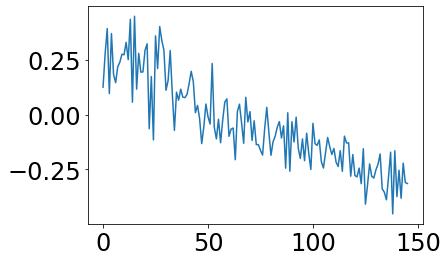

In [135]:
plt.plot(F_fit_session[cn_now,start_t:end_t])

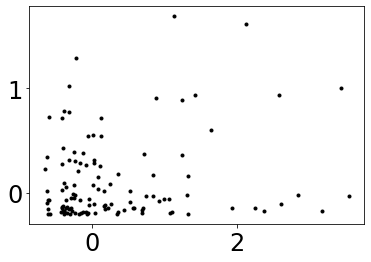

In [136]:
plt.plot(test_session_cn_amplitudes,test_amplitudes,'k.')

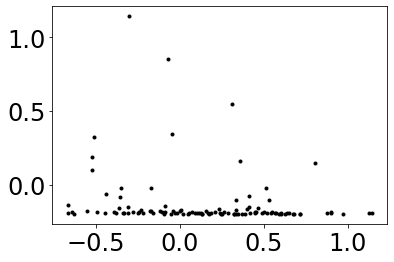

In [134]:
plt.plot(fit_session_cn_amplitudes,fit_amplitudes,'k.')


In [84]:
DLC_aligned_test_session.keys()

MultiIndex([(     'PawL',        'diff', 'x'),
            (     'PawL',        'diff', 'y'),
            (     'PawR',        'diff', 'x'),
            (     'PawR',        'diff', 'y'),
            (  'NoseTip',        'diff', 'x'),
            (  'NoseTip',        'diff', 'y'),
            (      'Jaw',        'diff', 'x'),
            (      'Jaw',        'diff', 'y'),
            ('TongueTip',        'diff', 'x'),
            ('TongueTip',        'diff', 'y'),
            ('TongueMid',        'diff', 'x'),
            ('TongueMid',        'diff', 'y'),
            (     'PawL', 'diff_signed', 'x'),
            (     'PawL', 'diff_signed', 'y'),
            (     'PawR', 'diff_signed', 'x'),
            (     'PawR', 'diff_signed', 'y'),
            (  'NoseTip', 'diff_signed', 'x'),
            (  'NoseTip', 'diff_signed', 'y'),
            (      'Jaw', 'diff_signed', 'x'),
            (      'Jaw', 'diff_signed', 'y'),
            ('TongueTip', 'diff_signed', 'x'),
            (

In [83]:
part

('PawL', 'mean', 'x')

NameError: name 'DLC_aligned_test_session' is not defined

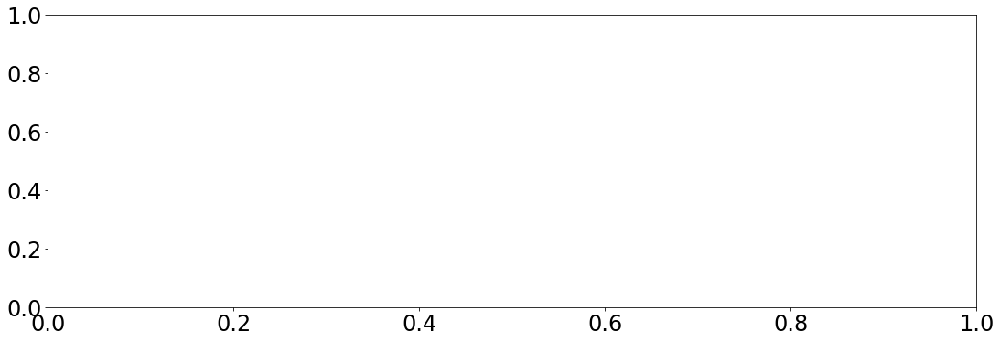

In [5]:
# movement trajectories for 10 trials
parts_to_plot = [(      'Jaw',        'mean', 'x'),
                 #(     'PawL',        'mean', 'x'),
                 (      'Jaw',        'diff', 'x'),
                 (     'PawL',        'diff', 'x'),
                 (      'Jaw',        'diff_signed', 'x'),
                 (     'PawL',        'diff_signed', 'x')
                ]

test_session = 2
minimum_trial_length = 3
trial_num = 10
trial_end_frames_test_session = np.asarray(multi_session_dict['trial_end_frames'][test_session])
trial_start_frames_test_session = np.concatenate([[0],trial_end_frames_test_session[:-1]])
trial_lens_test_session = (trial_end_frames_test_session - trial_start_frames_test_session)
needed_trials_test_session = trial_lens_test_session>=minimum_trial_length
fig = plt.figure(figsize = [40,20])
for part_i,part in enumerate(parts_to_plot):
    ax = fig.add_subplot(3,2,part_i+1)
    t_=0
    offset = 0
    for t in np.where(needed_trials_test_session)[0]:
        start_t =trial_start_frames_test_session[t]
        trial_length = np.min([trial_lens_test_session[t],200])
        
        t_trace = np.arange(trial_length)/20
        end_t = start_t+trial_length
        trace_now = DLC_aligned_test_session[part].values[start_t:end_t]
        trace_now = trace_now-np.nanmin(trace_now)
        offset -= np.nanmax(trace_now)
        ax.plot(t_trace,trace_now + offset,linewidth = 4)
        t_+=1
        if t_ == trial_num:
            break
        ax.set_title(part)
        if part_i >= len(parts_to_plot)-2:
            ax.set_xlabel('Time from trial start (s)')
        
          


In [304]:
fit_session_y_matrix.shape

(74, 161)

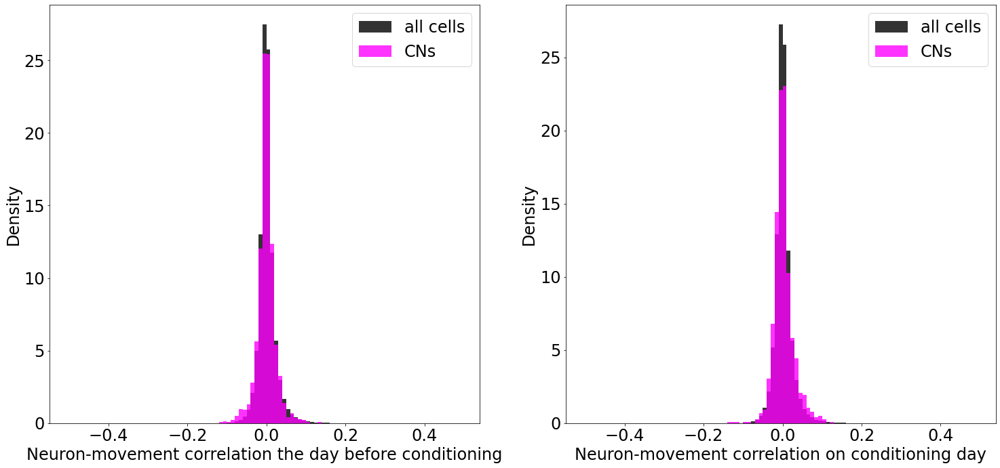

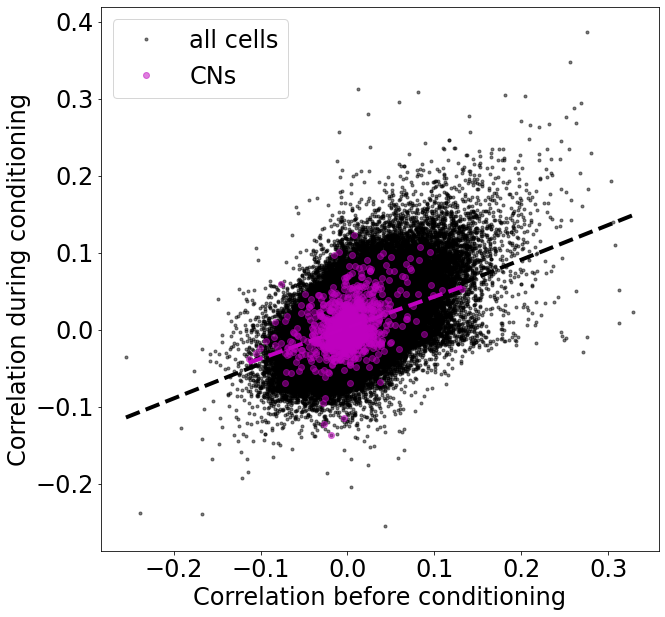

In [20]:
#distribution of movement changes
bins = np.arange(-.5,.5,.01)
fig = plt.figure(figsize = [25,25])
ax1 = fig.add_subplot(2,2,1)
#ax2 = ax1.twinx()
ax1.hist(np.concatenate(corr_with_cn_before_conditioning_day_all),bins,color = 'black',alpha = .8,label = 'all cells',density = True)
ax1.set_ylabel('Density')
ax1.hist(np.concatenate(corr_with_cn_before_conditioning_day_all)[np.concatenate(is_it_CN_all)],bins,color = 'magenta',alpha = .8,label = 'CNs',density = True)
# ax2.set_ylabel('CNs')
# ax2.yaxis.label.set_color('magenta')
# ax2.tick_params(axis='y', colors='magenta')
#ax2.spines['right'].set_color('magenta')
ax1.legend()


ax1.set_xlabel('Neuron-movement correlation the day before conditioning')


ax11 = fig.add_subplot(2,2,2)
#ax2 = ax1.twinx()
ax11.hist(np.concatenate(corr_with_cn_on_conditioning_day_all),bins,color = 'black',alpha = .8,label = 'all cells',density = True)
ax11.set_ylabel('Density')
ax11.hist(np.concatenate(corr_with_cn_on_conditioning_day_all)[np.concatenate(is_it_CN_all)],bins,color = 'magenta',alpha = .8,label = 'CNs',density = True)
# ax2.set_ylabel('CNs')
# ax2.yaxis.label.set_color('magenta')
# ax2.tick_params(axis='y', colors='magenta')
#ax2.spines['right'].set_color('magenta')
ax11.legend()
ax11.set_xlabel('Neuron-movement correlation on conditioning day')

fig = plt.figure(figsize = [10,10])
ax1 =fig.add_subplot(1,1,1) 
ax1.plot(np.concatenate(corr_with_cn_before_conditioning_day_all),np.concatenate(corr_with_cn_on_conditioning_day_all),'k.',alpha = .5,label = 'all cells')
x = np.concatenate(corr_with_cn_before_conditioning_day_all)
y = np.concatenate(corr_with_cn_on_conditioning_day_all)
needed = (np.isnan(x) | np.isnan(y))==False
x = x[needed]
y = y[needed]
p = np.polyfit(x,y,1)
xx = np.percentile(x,[0,100])
yy = np.polyval(p,xx)
ax1.plot(xx,yy,'k--',linewidth = 4)
ax1.plot(np.concatenate(corr_with_cn_before_conditioning_day_all)[np.concatenate(is_it_CN_all)],np.concatenate(corr_with_cn_on_conditioning_day_all)[np.concatenate(is_it_CN_all)],'mo',alpha = .5,label = 'CNs')
x = np.concatenate(corr_with_cn_before_conditioning_day_all)[np.concatenate(is_it_CN_all)]
y = np.concatenate(corr_with_cn_on_conditioning_day_all)[np.concatenate(is_it_CN_all)]
needed = (np.isnan(x) | np.isnan(y))==False
x = x[needed]
y = y[needed]
p = np.polyfit(x,y,1)
xx = np.percentile(x,[0,100])
yy = np.polyval(p,xx)
ax1.plot(xx,yy,'m--',linewidth = 4)

ax1.set_xlabel('Correlation before conditioning')
ax1.set_ylabel('Correlation during conditioning')
ax1.legend()

In [19]:
np.sum(np.isinf(x))

0

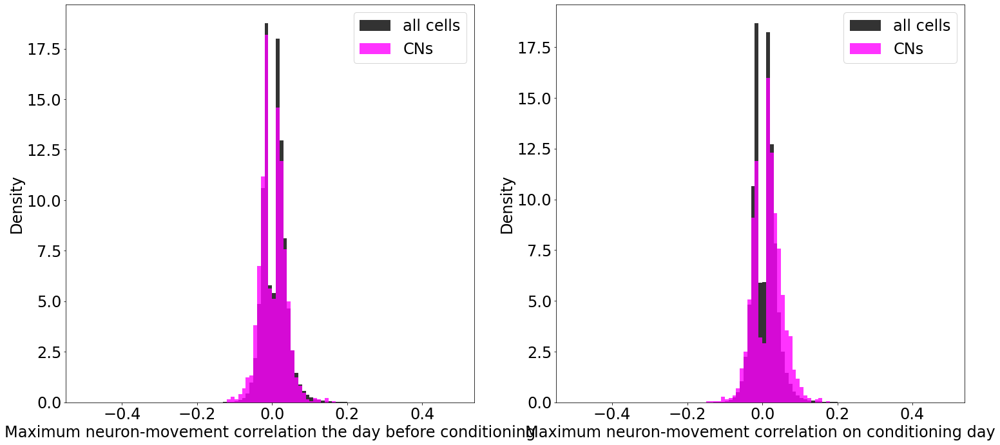

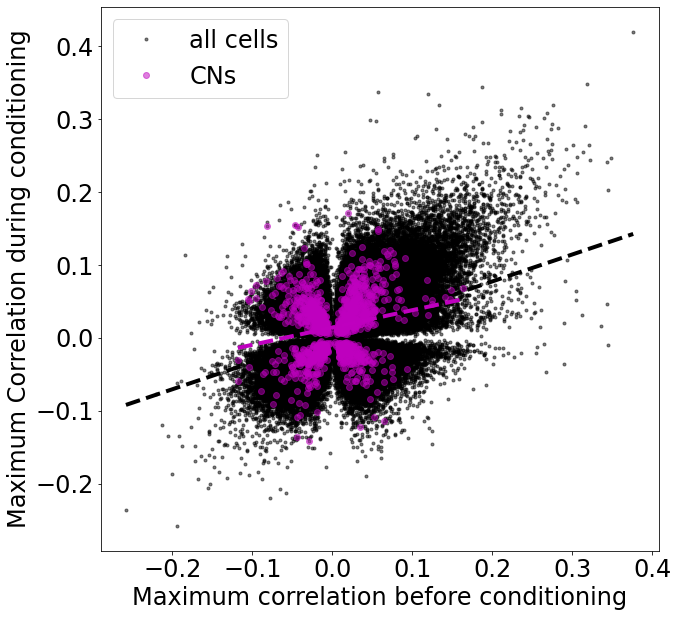

In [21]:
#distribution of movement changes with MAXIMUM correlations
bins = np.arange(-.5,.5,.01)
fig = plt.figure(figsize = [25,25])
ax1 = fig.add_subplot(2,2,1)
#ax2 = ax1.twinx()
ax1.hist(np.concatenate(max_corr_with_cn_before_conditioning_day_all),bins,color = 'black',alpha = .8,label = 'all cells',density = True)
ax1.set_ylabel('Density')
ax1.hist(np.concatenate(max_corr_with_cn_before_conditioning_day_all)[np.concatenate(is_it_CN_all)],bins,color = 'magenta',alpha = .8,label = 'CNs',density = True)
# ax2.set_ylabel('CNs')
# ax2.yaxis.label.set_color('magenta')
# ax2.tick_params(axis='y', colors='magenta')
#ax2.spines['right'].set_color('magenta')
ax1.legend()


ax1.set_xlabel('Maximum neuron-movement correlation the day before conditioning')


ax11 = fig.add_subplot(2,2,2)
#ax2 = ax1.twinx()
ax11.hist(np.concatenate(max_corr_with_cn_on_conditioning_day_all),bins,color = 'black',alpha = .8,label = 'all cells',density = True)
ax11.set_ylabel('Density')
ax11.hist(np.concatenate(max_corr_with_cn_on_conditioning_day_all)[np.concatenate(is_it_CN_all)],bins,color = 'magenta',alpha = .8,label = 'CNs',density = True)
# ax2.set_ylabel('CNs')
# ax2.yaxis.label.set_color('magenta')
# ax2.tick_params(axis='y', colors='magenta')
#ax2.spines['right'].set_color('magenta')
ax11.legend()
ax11.set_xlabel('Maximum neuron-movement correlation on conditioning day')

fig = plt.figure(figsize = [10,10])
ax1 =fig.add_subplot(1,1,1) 
ax1.plot(np.concatenate(max_corr_with_cn_before_conditioning_day_all),np.concatenate(max_corr_with_cn_on_conditioning_day_all),'k.',alpha = .5,label = 'all cells')
x = np.concatenate(max_corr_with_cn_before_conditioning_day_all)
y = np.concatenate(max_corr_with_cn_on_conditioning_day_all)
needed = (np.isnan(x) | np.isnan(y))==False
x = x[needed]
y = y[needed]
p = np.polyfit(x,y,1)
xx = np.percentile(x,[0,100])
yy = np.polyval(p,xx)
ax1.plot(xx,yy,'k--',linewidth = 4)
ax1.plot(np.concatenate(max_corr_with_cn_before_conditioning_day_all)[np.concatenate(is_it_CN_all)],np.concatenate(max_corr_with_cn_on_conditioning_day_all)[np.concatenate(is_it_CN_all)],'mo',alpha = .5,label = 'CNs')
x = np.concatenate(max_corr_with_cn_before_conditioning_day_all)[np.concatenate(is_it_CN_all)]
y = np.concatenate(max_corr_with_cn_on_conditioning_day_all)[np.concatenate(is_it_CN_all)]
needed = (np.isnan(x) | np.isnan(y))==False
x = x[needed]
y = y[needed]
p = np.polyfit(x,y,1)
xx = np.percentile(x,[0,100])
yy = np.polyval(p,xx)
ax1.plot(xx,yy,'m--',linewidth = 4)

ax1.set_xlabel('Maximum correlation before conditioning')
ax1.set_ylabel('Maximum Correlation during conditioning')
ax1.legend()




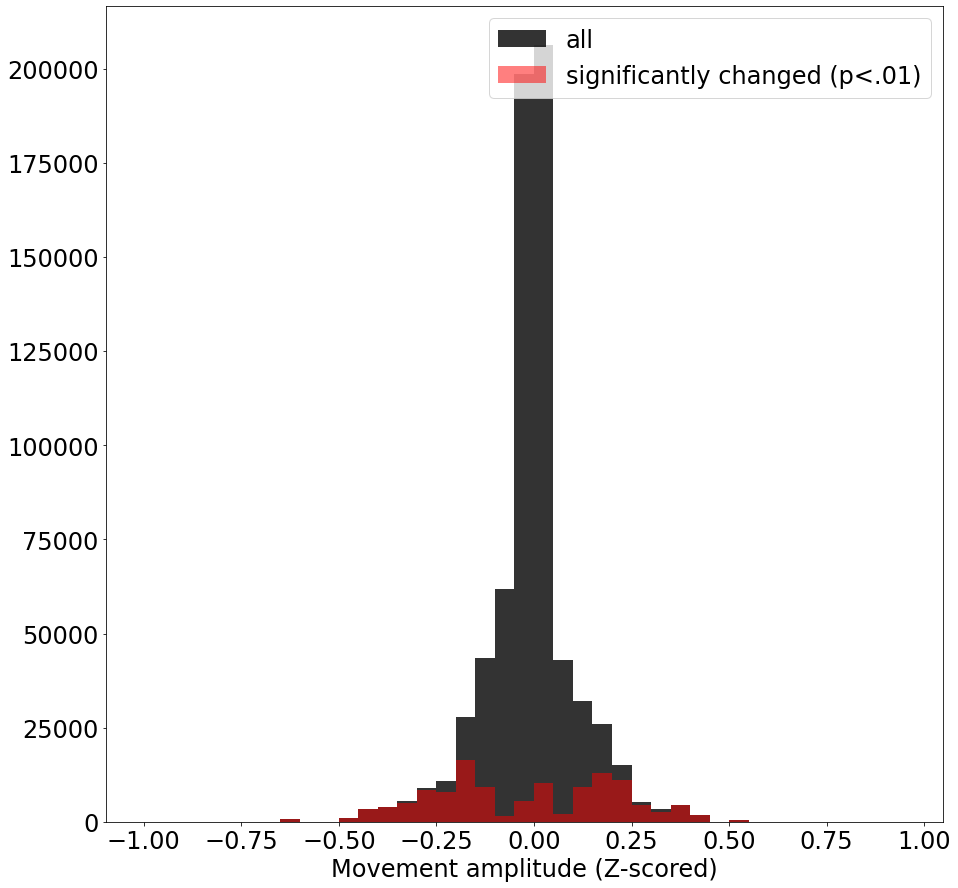

In [64]:
bins = np.arange(-1,1,.05)
y,x = np.histogram(np.concatenate(movement_amplitude_change_list_all),bins)
x = np.nanmean([x[1:],x[:-1]],0)
fig = plt.figure(figsize = [15,15])
ax1 = fig.add_subplot(1,1,1)
#ax1.plot(x,np.cumsum(y)/sum(y))
ax1.hist(np.concatenate(movement_amplitude_change_list_all),bins,color = 'black',alpha = .8,label = 'all')
#ax2 = ax1.twinx()
ax1.hist(np.concatenate(movement_amplitude_change_list_all)[np.concatenate(p_change_all)<.01],bins,color = 'red',alpha = .5,label = 'significantly changed (p<.01)')
ax1.set_xlabel('Movement amplitude (Z-scored)')
ax1.legend()

In [110]:
import matplotlib
font = {'family' : 'normal',
        #'weight' : 'bold',
        'size'   : 22}

matplotlib.rc('font', **font)


Text(0, 0.5, '# of ccs')

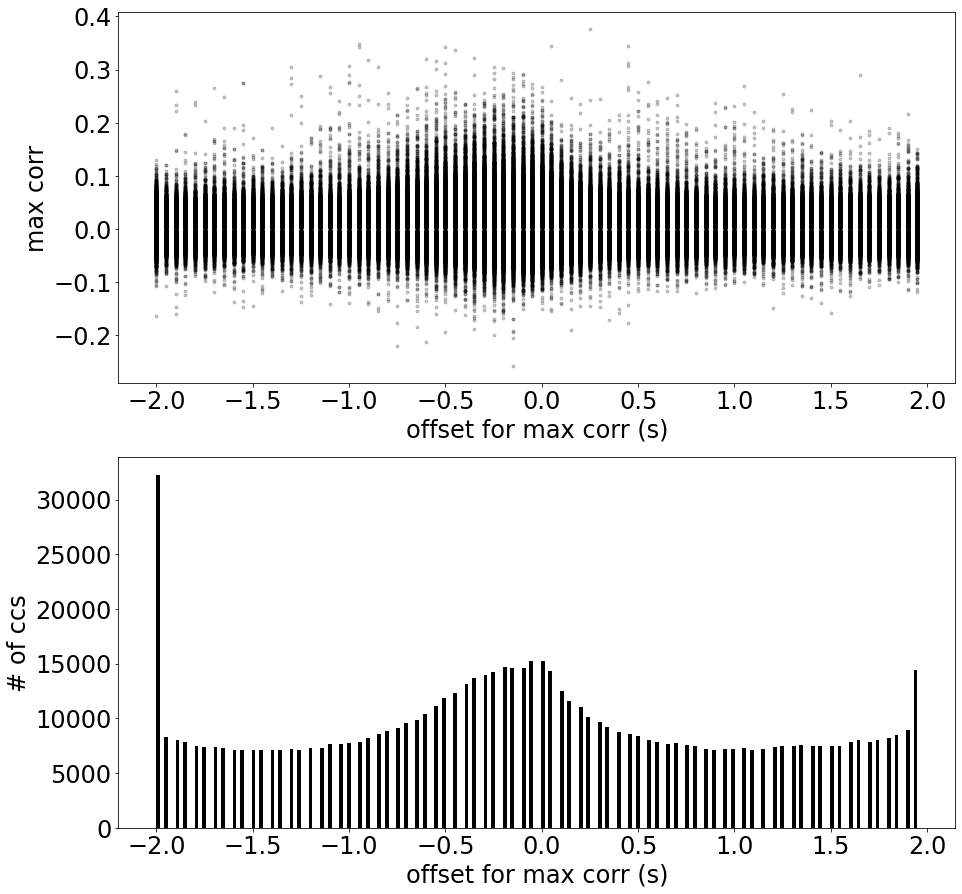

In [8]:
max_corr_with_cn_the_day_before = np.concatenate(max_corr_with_cn_before_conditioning_day_all)
max_corr_offset_with_cn_the_day_before = np.concatenate(max_corr_with_cn_before_conditioning_day_offset_all)
fig = plt.figure(figsize = [15,15])
ax  = fig.add_subplot(211)
ax.plot(max_corr_offset_with_cn_the_day_before,max_corr_with_cn_the_day_before,'k.',alpha= .2)
ax.set_xlabel('offset for max corr (s)')
ax.set_ylabel('max corr')
ax2  = fig.add_subplot(212,sharex = ax)
ax2.hist(max_corr_offset_with_cn_the_day_before,200,color= 'black')
ax2.set_xlabel('offset for max corr (s)')
ax2.set_ylabel('# of ccs')

Text(0, 0.5, 'delta movement amplitude')

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


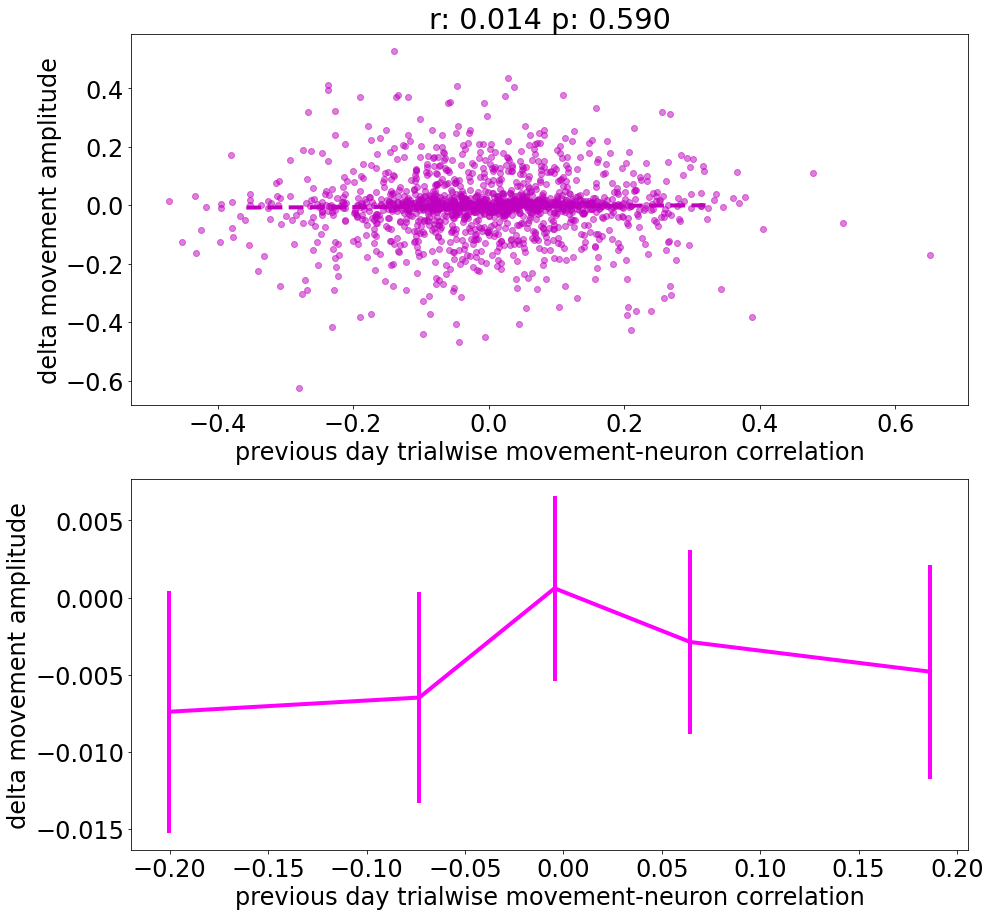

In [9]:
bin_num_x = 5
is_it_cn = np.concatenate(is_it_CN_all)
delta_movement_amplitude = np.concatenate(movement_amplitude_change_list_all)
ylabel = 'delta movement amplitude'

corr_with_cn_the_day_before = np.concatenate(corr_with_cn_before_conditioning_day_all)
#corr_with_cn_the_day_before = np.concatenate(max_corr_with_cn_before_conditioning_day_all)
xlabel = 'previous day movement-neuron correlation'

corr_with_cn_the_day_before = np.concatenate(trialwise_corr_with_cn_before_conditioning_day_all)
#corr_with_cn_the_day_before = np.concatenate(max_corr_with_cn_before_conditioning_day_all)
xlabel = 'previous day trialwise movement-neuron correlation'

# needed  = (corr_with_cn_the_day_before>-.01) & (corr_with_cn_the_day_before<.01)
# needed = needed == False
# is_it_cn = is_it_cn[needed]
# delta_movement_amplitude = delta_movement_amplitude[needed]
# corr_with_cn_the_day_before = corr_with_cn_the_day_before[needed]

fig = plt.figure(figsize = [15,15])
ax1 = fig.add_subplot(211)
ax2 = fig.add_subplot(212)
ax1.plot(corr_with_cn_the_day_before[is_it_cn],delta_movement_amplitude[is_it_cn],'mo',alpha = .5)



x_list_all = corr_with_cn_the_day_before[is_it_cn]
y_list_all = delta_movement_amplitude[is_it_cn]
r,t= scipy.stats.pearsonr(x_list_all,y_list_all)
p = np.polyfit(x_list_all,y_list_all,1)
xvals = np.percentile(x_list_all,[1,99])
ax1.plot(xvals,np.polyval(p,xvals),'m--',linewidth = 4)
ax1.set_title('r: {:.3f} p: {:.3f}'.format(r,t))

x_sorted = np.sort(x_list_all)
x_starts = x_sorted[::int(np.floor(len(x_list_all)/(bin_num_x)))-1]
x_ends = x_starts[1:]
x_starts = x_starts[:-1]

x_values_plotted = []
y_values_plotted = []
y_stds_plotted = []
for xi,(x_s,x_e) in enumerate(zip(x_starts,x_ends)):
    needed_indices = (x_list_all>=x_s)&(x_list_all<=x_e)
    x_values_plotted.append(np.nanmean(x_list_all[needed_indices]))
    y_values_plotted.append(np.nanmean(y_list_all[needed_indices]))
    y_stds_plotted.append(np.nanstd(y_list_all[needed_indices])/np.sqrt(sum(needed_indices)))

    
ax2.errorbar(x_values_plotted,y_values_plotted,y_stds_plotted,color = 'magenta',linewidth = 4)


ax1.set_xlabel(xlabel)
ax1.set_ylabel(ylabel)
ax2.set_xlabel(xlabel)
ax2.set_ylabel(ylabel)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


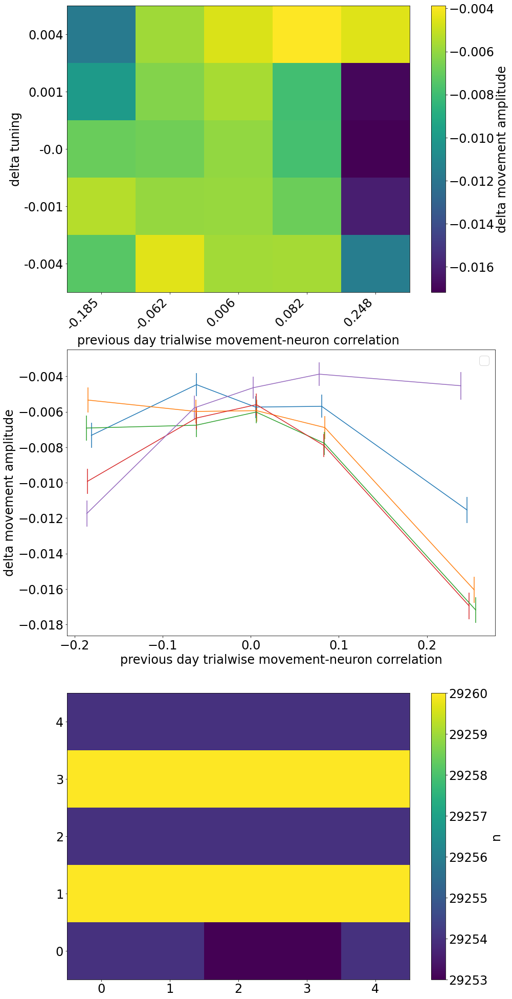

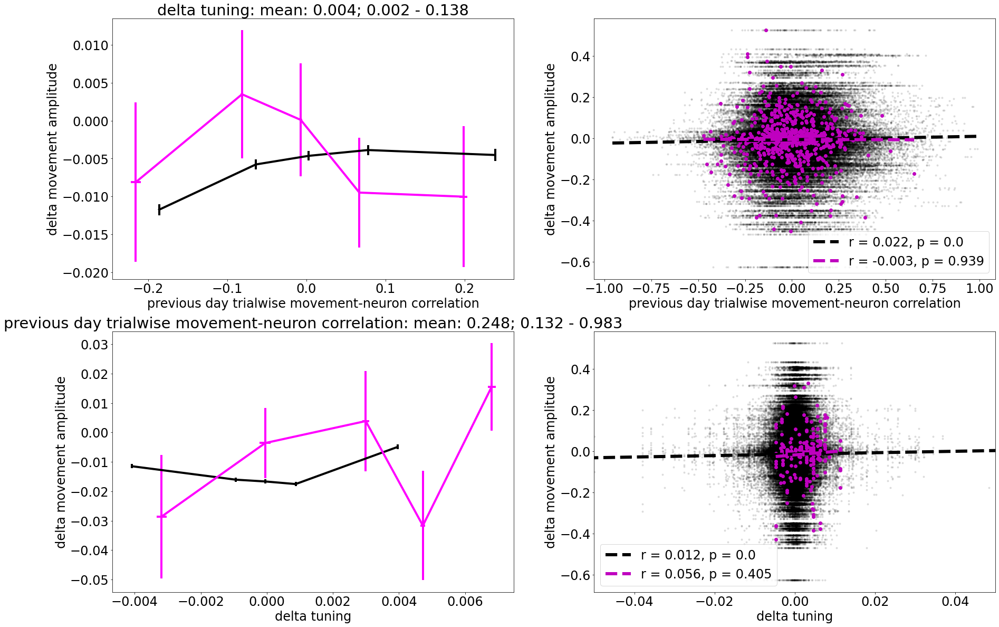

In [26]:
from mpl_toolkits.mplot3d import Axes3D
#%matplotlib inline
delta_tuning = np.concatenate(delta_tuning_all)#
previous_tuning = np.concatenate(previous_tuning_all) # +
current_tuning = previous_tuning+delta_tuning

previous_reward_tuning = np.concatenate(previous_reward_tuning_all) # +
reward_tuning = np.concatenate(reward_tuning_all) # +

delta_movement_amplitude = np.concatenate(movement_amplitude_change_list_all)
corr_with_cn_the_day_before = np.concatenate(corr_with_cn_before_conditioning_day_all)
corr_with_cn_the_day_before_trialwise = np.concatenate(trialwise_corr_with_cn_before_conditioning_day_all)
max_corr_with_cn_the_day_before = np.concatenate(max_corr_with_cn_before_conditioning_day_all)
max_corr_offset_with_cn_the_day_before = np.concatenate(max_corr_with_cn_before_conditioning_day_offset_all)

corr_with_cn_today = np.concatenate(corr_with_cn_on_conditioning_day_all)

show_cn_only = True

bin_num_y  = 5
bin_num_x = 5

bin_num_y_cn  = 5
bin_num_x_cn = 5
equalize_bin_n = True

y_base_list_all = delta_tuning
third_axis_label = 'delta tuning'

# y_base_list_all = previous_tuning
# third_axis_label = 'tuning on previous session'

# y_base_list_all = current_tuning
# third_axis_label = 'tuning on conditioning session'

# y_base_list_all = reward_tuning
# third_axis_label = 'reward tuning'

# y_base_list_all = previous_reward_tuning
# third_axis_label = 'reward tuning on previous session'


# y_base_list_all = max_corr_offset_with_cn_the_day_before
# third_axis_label = 'previous day peak correlation offset (s)'


x_list_all = corr_with_cn_the_day_before
xlabel = 'previous day movement-neuron correlation'

x_list_all = max_corr_with_cn_the_day_before
xlabel = 'previous day MAX movement-neuron correlation'

x_list_all = corr_with_cn_the_day_before_trialwise
xlabel = 'previous day trialwise movement-neuron correlation'


y_list_all =  delta_movement_amplitude
ylabel = 'delta movement amplitude'

# y_list_all = corr_with_cn_today-corr_with_cn_the_day_before
# ylabel = 'delta movement-neuron correlation'

# y_list_all = max_corr_offset_with_cn_the_day_before
# ylabel = 'previous day peak correlation offset (s)'

non_nan = (np.isnan(x_list_all) | np.isnan(y_base_list_all) | np.isnan(y_list_all))==False
x_list_all = x_list_all[non_nan]
y_base_list_all = y_base_list_all[non_nan]
y_list_all = y_list_all[non_nan]



x_sorted = np.sort(x_list_all)
x_starts = x_sorted[::int(np.floor(len(x_list_all)/(bin_num_x)))-1]
x_ends = x_starts[1:]
x_starts = x_starts[:-1]

x_values_plotted = []
for xi,(x_s,x_e) in enumerate(zip(x_starts,x_ends)):
    needed_indices = (x_list_all>=x_s)&(x_list_all<=x_e)
    x_values_plotted.append(np.nanmean(x_list_all[needed_indices]))

y_base_sorted = np.sort(y_base_list_all)
y_base_sorted = y_base_sorted[np.isnan(y_base_sorted)==False]
y_starts = y_base_sorted[::int(np.floor(len(y_base_sorted)/(bin_num_y)))-1]
y_ends = y_starts[1:]
y_starts = y_starts[:-1]

bin_matrix = np.zeros([bin_num_x,bin_num_y])*np.nan
y_base_values= []
x_matrix = np.zeros([bin_num_x,bin_num_y])*np.nan
error_matrix = np.zeros([bin_num_x,bin_num_y])*np.nan
n_matrix = np.zeros([bin_num_x,bin_num_y])*np.nan
for yi,(y_s,y_e) in enumerate(zip(y_starts,y_ends)):
    needed_indices = (y_base_list_all>=y_s)&(y_base_list_all<=y_e)
    y_base_values.append(np.nanmean(y_base_list_all[needed_indices]))
    x_list = x_list_all[needed_indices]
    y_list = y_list_all[needed_indices]

    if equalize_bin_n:
        x_sorted = np.sort(x_list)
        x_starts = x_sorted[::int(np.floor(len(x_list)/(bin_num_x)))-1]
        x_ends = x_starts[1:]
        x_starts = x_starts[:-1]   
    
    
    for xi,(x_s,x_e) in enumerate(zip(x_starts,x_ends)):
        needed_indices = (x_list>=x_s)&(x_list<=x_e)
        n = sum(needed_indices)
        bin_matrix[xi,yi] = np.nanmean(y_list[needed_indices])
        x_matrix[xi,yi] = np.nanmean(x_list[needed_indices])
        error_matrix[xi,yi] = np.nanstd(y_list[needed_indices])/np.sqrt(n)
        n_matrix[xi,yi] = len(np.unique(x_list[needed_indices]))


fig = plt.figure(figsize = [15,35])
ax = fig.add_subplot(3,1,1)
im = ax.imshow(bin_matrix.T,aspect = 'auto',interpolation = 'none',origin = 'lower')
ax.set_yticks(np.arange(bin_num_y))
ax.set_yticklabels(np.round(y_base_values,3))
ax.set_xticks(np.arange(bin_num_x))
ax.set_xticklabels(np.round(x_values_plotted,3))
ax.set_ylabel(third_axis_label)
ax.set_xlabel(xlabel)
plt.xticks(rotation=45, ha='right')
fig.colorbar(im,ax = ax,label = ylabel)

ax = fig.add_subplot(3,1,2)
for x,y,err in zip(x_matrix.T,bin_matrix.T,error_matrix.T):#,['inhibitory','in-between','excitatory']):
    ax.errorbar(x,y,err)#,label = l)
ax.set_ylabel(ylabel)
ax.set_xlabel(xlabel)
ax.legend()

ax = fig.add_subplot(3,1,3)
im = ax.imshow(n_matrix.T,aspect = 'auto',interpolation = 'none',origin = 'lower')
fig.colorbar(im,ax = ax,label = 'n')








# plot last row and column - and then the CNs on top
bin_idx_to_plot = -1
fig = plt.figure(figsize = [30,20])
ax1 = fig.add_subplot(2,2,1)
ax11 = fig.add_subplot(2,2,2)


needed_indices = (y_base_list_all>=y_starts[bin_idx_to_plot])&(y_base_list_all<=y_ends[bin_idx_to_plot])
mean_min_max_y_base = [np.nanmean(y_base_list_all[needed_indices]),y_starts[bin_idx_to_plot],y_ends[bin_idx_to_plot]]
x_list = x_list_all[needed_indices]
y_list = y_list_all[needed_indices]
is_it_cn = np.concatenate(is_it_CN_all)[non_nan][needed_indices]


x_sorted = np.sort(x_list)
x_starts = x_sorted[::int(np.floor(len(x_list)/(bin_num_x)))-1]
x_ends = x_starts[1:]
x_starts = x_starts[:-1] 

x_vals = []
y_vals = []
x_errors = []
y_errors = []
ns = []
for xi,(x_s,x_e) in enumerate(zip(x_starts,x_ends)):
    needed_indices = (x_list>=x_s)&(x_list<=x_e)
    n = sum(needed_indices)
    y_vals.append(np.nanmean(y_list[needed_indices]))
    x_vals.append(np.nanmean(x_list[needed_indices]))
    y_errors.append(np.nanstd(y_list[needed_indices])/np.sqrt(n))
    x_errors.append(np.nanstd(x_list[needed_indices])/np.sqrt(n))
    ns.append(len(np.unique(x_list[needed_indices])))

    
ax11.plot(x_list,y_list,'k.',alpha = .1)
if show_cn_only:
    ax11.plot(x_list[is_it_cn],y_list[is_it_cn],'mo',alpha = 1)
ax11.set_ylabel(ylabel)
ax11.set_xlabel(xlabel)

r,t= scipy.stats.pearsonr(x_list,y_list)
p = np.polyfit(x_list,y_list,1)
x_ = np.percentile(x_list,[0,100])
ax11.plot(x_,np.polyval(p,x_),'k--', linewidth  = 6,label = 'r = {}, p = {}'.format(np.round(r,3),np.round(t,3)))

if show_cn_only:
    r,t= scipy.stats.pearsonr(x_list[is_it_cn],y_list[is_it_cn])
    p = np.polyfit(x_list[is_it_cn],y_list[is_it_cn],1)
    x_ = np.percentile(x_list[is_it_cn],[0,100])
    ax11.plot(x_,np.polyval(p,x_),'m--', linewidth = 6,label = 'r = {}, p = {}'.format(np.round(r,3),np.round(t,3)))

ax11.legend()

ax1.errorbar(x_vals,y_vals,y_errors,x_errors,linewidth = 4, elinewidth=4, color = 'black')
ax1.set_ylabel(ylabel)
ax1.set_xlabel(xlabel)
ax1.set_title('{}: mean: {}; {} - {}'.format(third_axis_label,
                                            np.round(mean_min_max_y_base[0],3),
                                           np.round(mean_min_max_y_base[1],3),
                                           np.round(mean_min_max_y_base[2],3)))

if show_cn_only:
    x_list = x_list[is_it_cn]
    y_list = y_list[is_it_cn]


    x_sorted = np.sort(x_list)
    x_starts = x_sorted[::int(np.floor(len(x_list)/(bin_num_x_cn)))-1]
    x_ends = x_starts[1:]
    x_starts = x_starts[:-1] 

    x_vals = []
    y_vals = []
    x_errors = []
    y_errors = []
    ns = []
    for xi,(x_s,x_e) in enumerate(zip(x_starts,x_ends)):
        needed_indices = (x_list>=x_s)&(x_list<=x_e)
        n = sum(needed_indices)
        y_vals.append(np.nanmean(y_list[needed_indices]))
        x_vals.append(np.nanmean(x_list[needed_indices]))
        y_errors.append(np.nanstd(y_list[needed_indices])/np.sqrt(n))
        x_errors.append(np.nanstd(x_list[needed_indices])/np.sqrt(n))
        ns.append(len(np.unique(x_list[needed_indices])))


    ax1.errorbar(x_vals,y_vals,y_errors,x_errors,linewidth = 4, elinewidth=4, color = 'magenta')







bin_idx_to_plot = -1
ax2 = fig.add_subplot(2,2,3)
ax22 = fig.add_subplot(2,2,4)
x_sorted = np.sort(x_list_all)
x_starts = x_sorted[::int(np.floor(len(x_list_all)/(bin_num_x)))-1]
x_ends = x_starts[1:]
x_starts = x_starts[:-1]


needed_indices = (x_list_all>=x_starts[bin_idx_to_plot])&(x_list_all<=x_ends[bin_idx_to_plot])
mean_min_max_x = [np.nanmean(x_list_all[needed_indices]),x_starts[bin_idx_to_plot],x_ends[bin_idx_to_plot]]
x_list = x_list_all[needed_indices]
y_list = y_list_all[needed_indices]
y_base_list = y_base_list_all[needed_indices]
is_it_cn = np.concatenate(is_it_CN_all)[non_nan][needed_indices]


y_base_sorted = np.sort(y_base_list)
y_base_starts = y_base_sorted[::int(np.floor(len(y_base_list)/(bin_num_y)))-1]
y_base_ends = y_base_starts[1:]
y_base_starts = y_base_starts[:-1] 


y_base_vals = []
y_vals = []
y_base_errors = []
y_errors = []
ns = []
for xi,(x_s,x_e) in enumerate(zip(y_base_starts,y_base_ends)):
    needed_indices = (y_base_list>=x_s)&(y_base_list<=x_e)
    n = sum(needed_indices)
    y_vals.append(np.nanmean(y_list[needed_indices]))
    y_base_vals.append(np.nanmean(y_base_list[needed_indices]))
    y_errors.append(np.nanstd(y_list[needed_indices])/np.sqrt(n))
    y_base_errors.append(np.nanstd(y_base_list[needed_indices])/np.sqrt(n))
    ns.append(len(np.unique(y_base_list[needed_indices])))

ax22.plot(y_base_list,y_list,'k.',alpha = .1)
if show_cn_only:
    ax22.plot(y_base_list[is_it_cn],y_list[is_it_cn],'mo',alpha = 1)
ax22.set_ylabel(ylabel)
ax22.set_xlabel(third_axis_label)    
ax22.set_xlim([-.05,.05])

r,t= scipy.stats.pearsonr(y_base_list,y_list)
p = np.polyfit(y_base_list,y_list,1)
x_ = np.percentile(y_base_list,[0,100])
ax22.plot(x_,np.polyval(p,x_),'k--', linewidth  = 6,label = 'r = {}, p = {}'.format(np.round(r,3),np.round(t,3)))
if show_cn_only:
    r,t= scipy.stats.pearsonr(y_base_list[is_it_cn],y_list[is_it_cn])
    p = np.polyfit(y_base_list[is_it_cn],y_list[is_it_cn],1)
    x_ = np.percentile(y_base_list[is_it_cn],[0,100])
    ax22.plot(x_,np.polyval(p,x_),'m--', linewidth = 6,label = 'r = {}, p = {}'.format(np.round(r,3),np.round(t,3)))

ax22.legend()



ax2.errorbar(y_base_vals,y_vals,y_errors,y_base_errors,linewidth = 4, elinewidth=4, color = 'black')
ax2.set_ylabel(ylabel)
ax2.set_xlabel(third_axis_label)
ax2.set_title('{}: mean: {}; {} - {}'.format(xlabel,
                                            np.round(mean_min_max_x[0],3),
                                           np.round(mean_min_max_x[1],3),
                                           np.round(mean_min_max_x[2],3)))



if show_cn_only:
    x_list = x_list[is_it_cn]
    y_list = y_list[is_it_cn]
    y_base_list = y_base_list[is_it_cn]


    y_base_sorted = np.sort(y_base_list)
    y_base_starts = y_base_sorted[::int(np.floor(len(y_base_list)/(bin_num_y_cn)))-1]
    y_base_ends = y_base_starts[1:]
    y_base_starts = y_base_starts[:-1] 


    y_base_vals = []
    y_vals = []
    y_base_errors = []
    y_errors = []
    ns = []
    for xi,(x_s,x_e) in enumerate(zip(y_base_starts,y_base_ends)):
        needed_indices = (y_base_list>=x_s)&(y_base_list<=x_e)
        n = sum(needed_indices)
        y_vals.append(np.nanmean(y_list[needed_indices]))
        y_base_vals.append(np.nanmean(y_base_list[needed_indices]))
        y_errors.append(np.nanstd(y_list[needed_indices])/np.sqrt(n))
        y_base_errors.append(np.nanstd(y_base_list[needed_indices])/np.sqrt(n))
        ns.append(len(np.unique(y_base_list[needed_indices])))

    ax2.errorbar(y_base_vals,y_vals,y_errors,y_base_errors,linewidth = 4, elinewidth=4, color = 'magenta')





# fig = plt.figure(figsize = [15,15])
# #ax1 = plt.axes(projection ="3d")
# ax1 = Axes3D(fig)
# ax1.scatter3D(delta_tuning, corr_with_cn_the_day_before, delta_movement_amplitude, marker='.',alpha = .2)
# ax1.set_xlabel('delta tuning')
# ax1.set_ylabel('Correlation with CN the day before')
# ax1.set_zlabel('Delta movement amplitude')
# ax1.view_init(elev=30, azim=66)#, roll=15)

(5000.0, 6000.0)

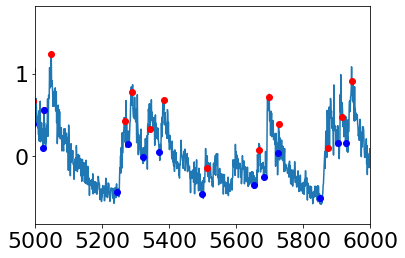

In [116]:
filt_F = BCI_analysis.plot_utils.rollingfun(F,10)
diff_F = np.diff(filt_F)
peaks = scipy.signal.find_peaks(diff_F,height = [0,np.inf])
event_start_list = []
event_peak_list = []
event_amplitude_list = []
for i in range(10000):
    end = np.argmax(diff_F)
    start = end
    while diff_F[start]>0 & start>0:
        start -= 1
    while filt_F[start]<np.nanmean(filt_F[start:start+5]) start>0:
        start-=1
    while diff_F[end]>0 & end<len(diff_F):
        end += 1
    # while filt_F[end]>np.nanmean(filt_F[end-5:end]):
    #     end+=1
    event_start_list.append(start)
    event_peak_list.append(end)
    filt_F[start:end] = 0
    diff_F[start:end] = 0
    event_amplitude_list.append(F[end]-F[start])
needed =    np.asarray(event_amplitude_list)>.25
event_peak_list = np.asarray(event_peak_list)[needed]
event_start_list = np.asarray(event_start_list)[needed]
plt.plot(F)
plt.plot(event_peak_list,F[event_peak_list],'ro')
plt.plot(event_start_list,F[event_start_list],'bo')
plt.xlim([5000,6000])

In [203]:
step_forward_dlc

163.0

In [185]:
np.percentile(dlc_trace_together,[1,99])

array([ 1.8397158 , 35.37165231])

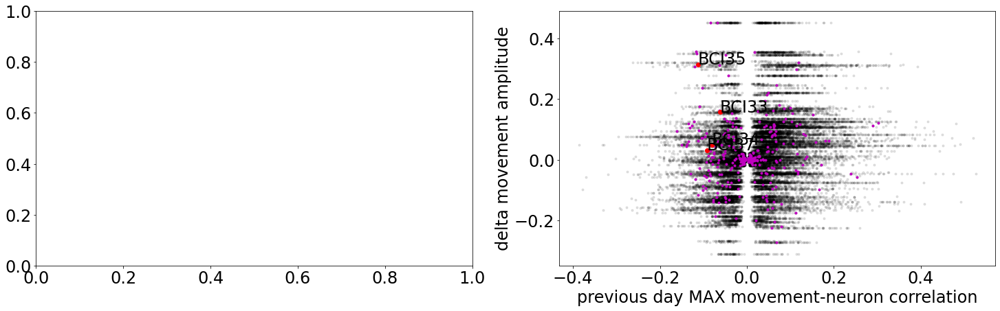

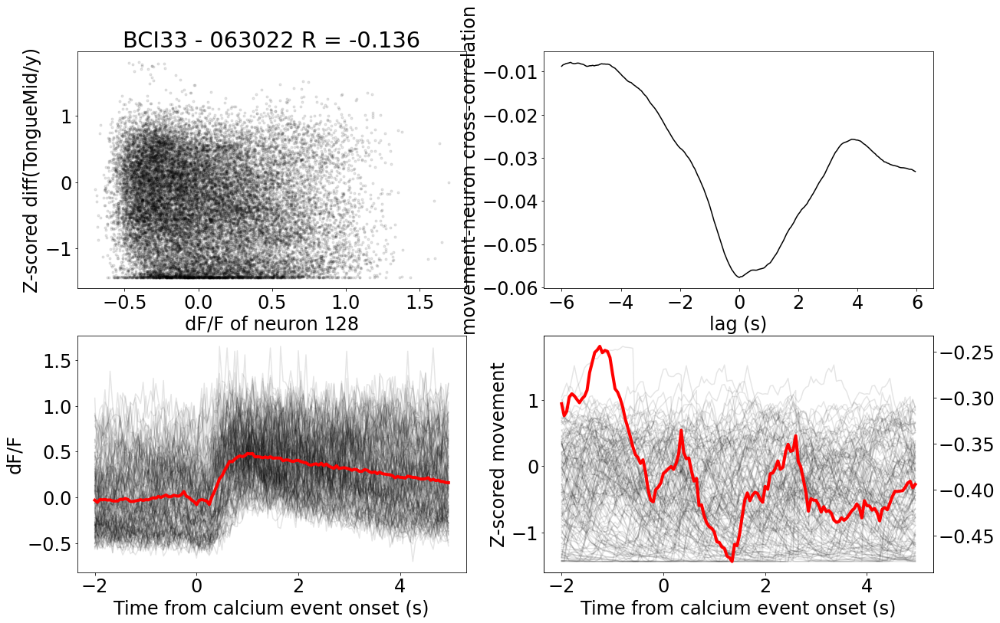

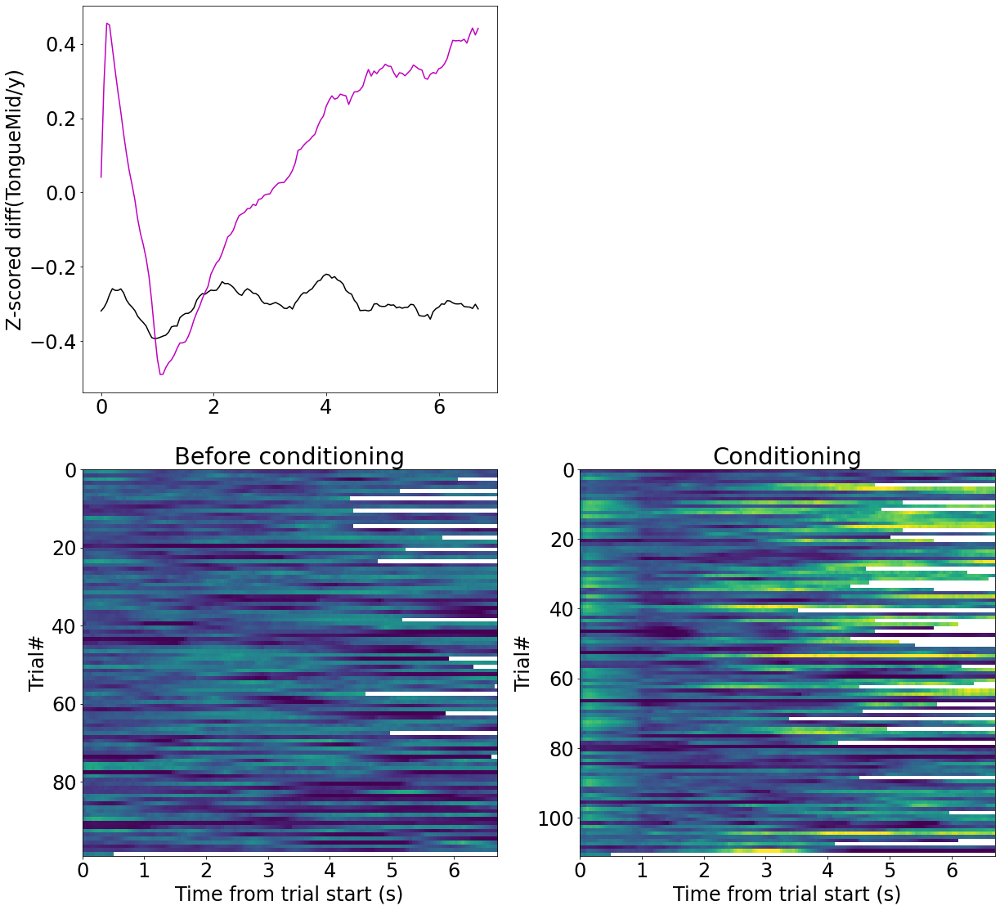

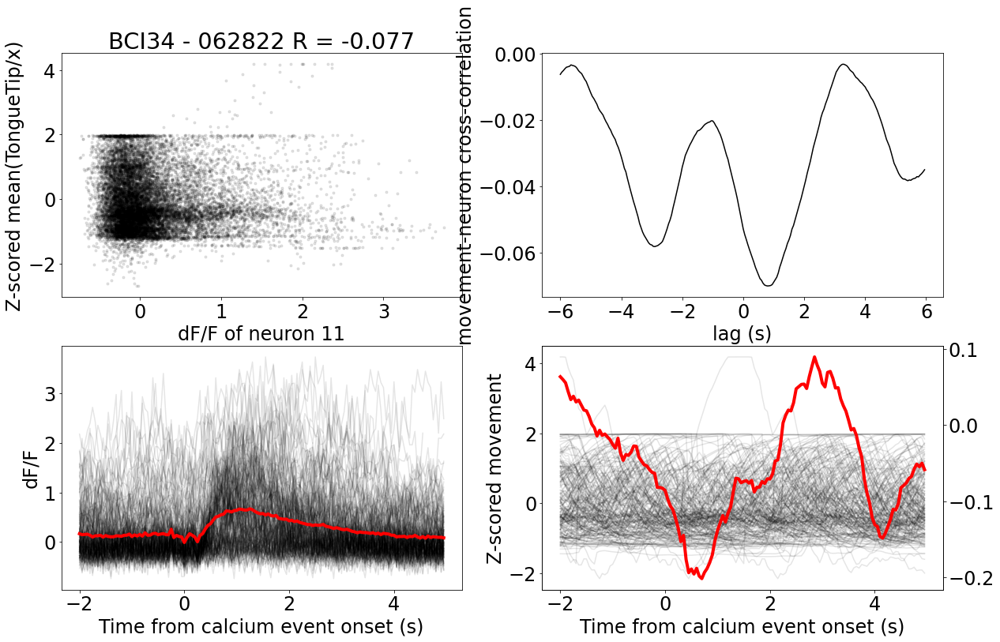

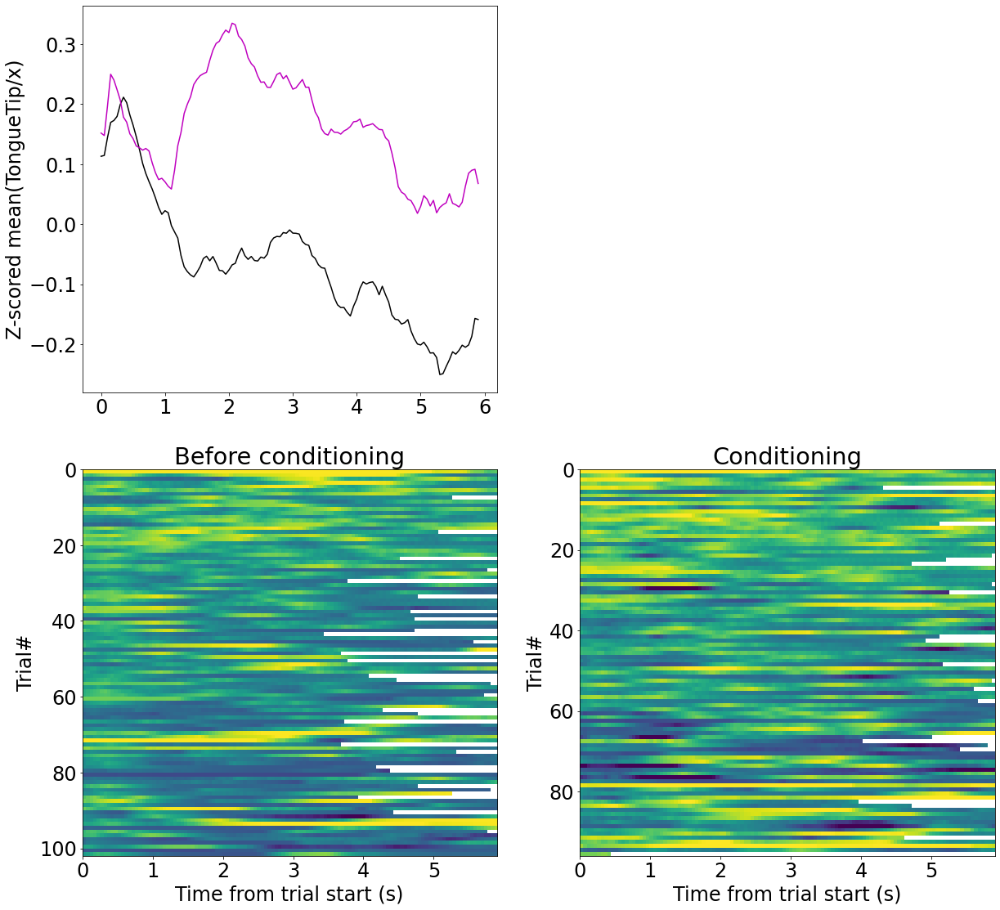

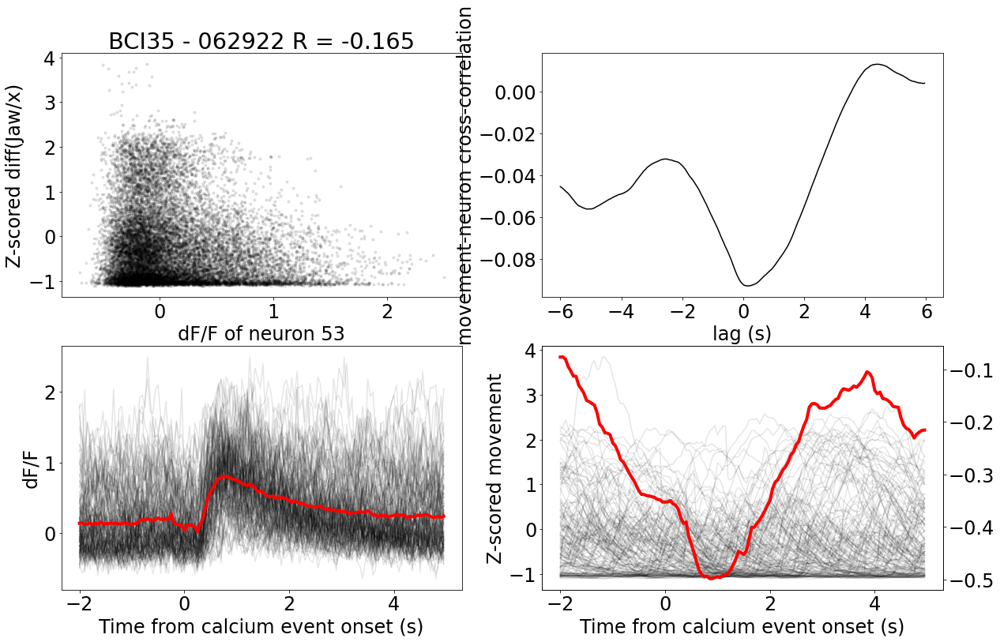

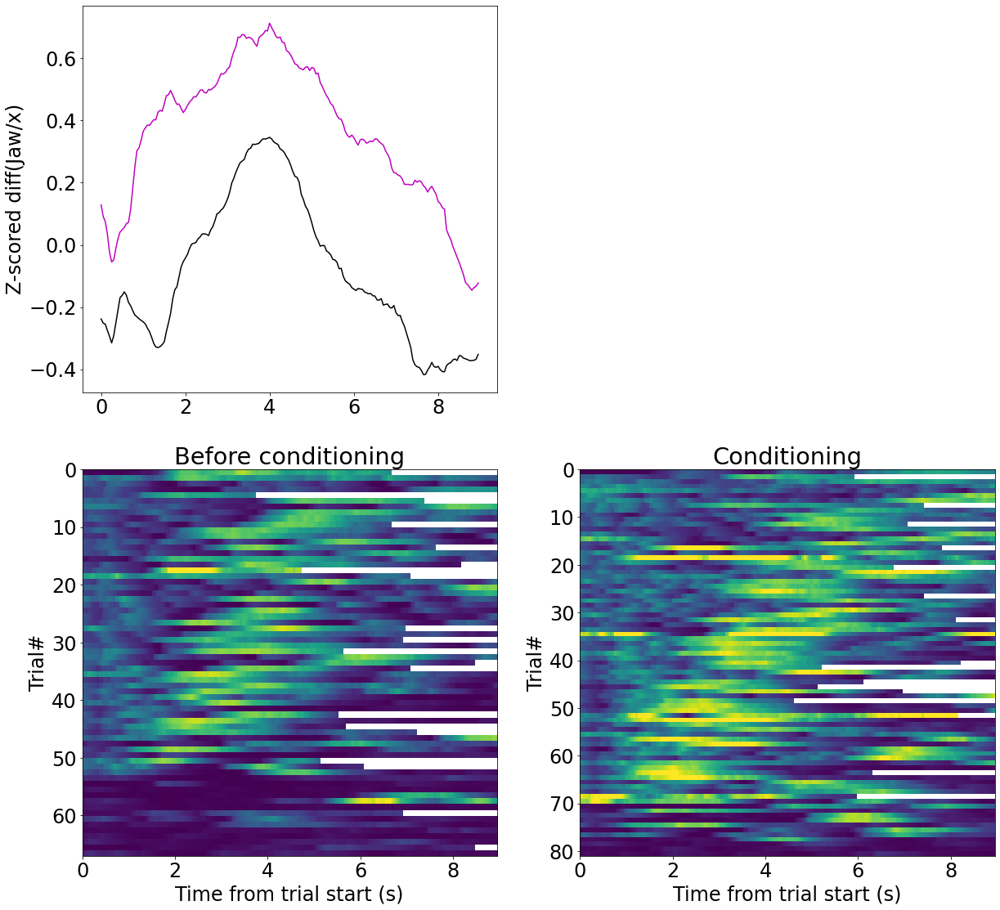

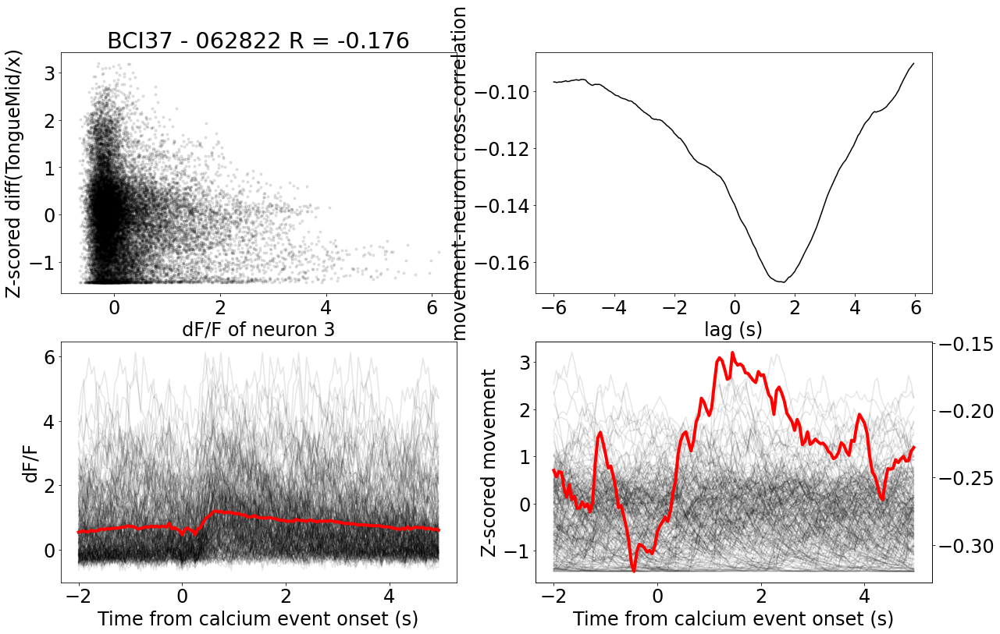

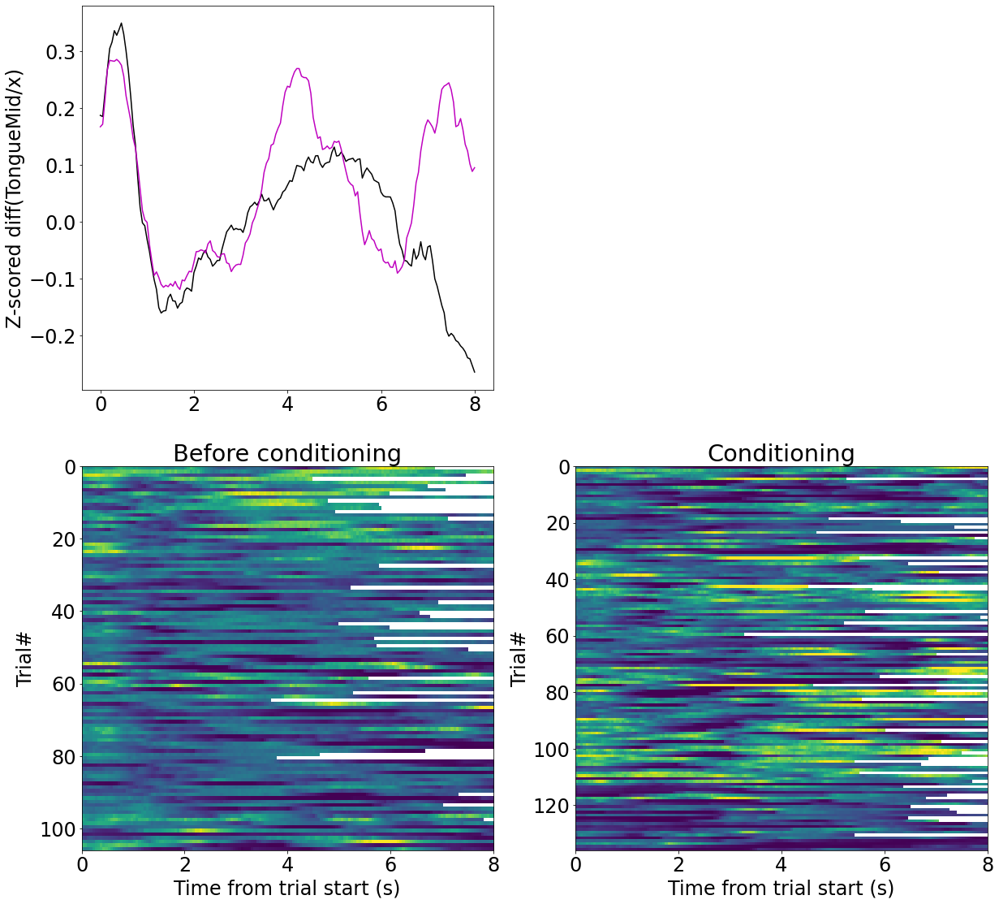

In [423]:
# azonositsuk azokat a sejteket es mozgasokat, akik erdekes helyen vannak
# first bin of first plot:
bin_idx_to_plot = -1
bin_idx_to_plot_2 = 0#bin_num_x-1#0
only_CN = True


fig = plt.figure(figsize = [25,15])
ax1 = fig.add_subplot(2,2,1)
ax2 = fig.add_subplot(2,2,2)

needed_indices = (y_base_list_all>=y_starts[bin_idx_to_plot])&(y_base_list_all<=y_ends[bin_idx_to_plot])
mean_min_max_y_base = [np.nanmean(y_base_list_all[needed_indices]),y_starts[bin_idx_to_plot],y_ends[bin_idx_to_plot]]
x_list = x_list_all[needed_indices]
y_list = y_list_all[needed_indices]
is_it_cn = np.concatenate(is_it_CN_all)[needed_indices]
cell_id_list  = np.concatenate(cell_id_list_all)[needed_indices]
part_id_list  = np.concatenate(part_id_list_all)[needed_indices]
sessions_list  = np.concatenate(sessions_list_all)[needed_indices]
previous_sessions_list  = np.concatenate(previous_sessions_list_all)[needed_indices]
mouse_list  = np.concatenate(mouse_list_all)[needed_indices]



ax2.plot(x_list,y_list,'k.',alpha = .1)
if only_CN:
    ax2.plot(x_list[is_it_cn],y_list[is_it_cn],'m.',alpha = 1)
ax2.set_ylabel(ylabel)
ax2.set_xlabel(xlabel)




if only_CN:
    x_list = x_list[is_it_cn]
    y_list = y_list[is_it_cn]
    cell_id_list  = cell_id_list[is_it_cn]
    part_id_list  = part_id_list[is_it_cn]
    sessions_list  = sessions_list[is_it_cn]
    previous_sessions_list  = previous_sessions_list[is_it_cn]
    mouse_list  = mouse_list[is_it_cn]
    is_it_cn  = is_it_cn[is_it_cn]


    
    
    
x_sorted = np.sort(x_list)
x_starts = x_sorted[::int(np.floor(len(x_list)/(bin_num_x)))-1]
x_ends = x_starts[1:]
x_starts = x_starts[:-1] 

x_vals = []
y_vals = []
x_errors = []
y_errors = []
ns = []
for xi,(x_s,x_e) in enumerate(zip(x_starts,x_ends)):
    needed_indices = (x_list>=x_s)&(x_list<=x_e)
    n = sum(needed_indices)
    y_vals.append(np.nanmean(y_list[needed_indices]))
    x_vals.append(np.nanmean(x_list[needed_indices]))
    y_errors.append(np.nanstd(y_list[needed_indices])/np.sqrt(n))
    x_errors.append(np.nanstd(x_list[needed_indices])/np.sqrt(n))
    ns.append(len(np.unique(x_list[needed_indices])))
    if xi == bin_idx_to_plot_2:
        #ax2.plot(x_list[needed_indices],y_list[needed_indices],'ro',alpha = .5)
        
        selected_x_list = x_list[needed_indices]
        selected_y_list = y_list[needed_indices]
        selected_cell_id_list = cell_id_list[needed_indices]
        selected_part_id_list = part_id_list[needed_indices]
        selected_sessions_list = sessions_list[needed_indices]
        selected_previous_sessions_list = previous_sessions_list[needed_indices]
        selected_mouse_list = mouse_list[needed_indices]
        order = []
        for mouse in np.unique(selected_mouse_list):
            selected_y_list_copy = selected_y_list.copy()
            selected_y_list_copy[selected_mouse_list!=mouse] = np.inf
            #index_now = np.where(selected_y_list_copy==np.nanmedian(selected_y_list_copy[selected_mouse_list==mouse]))[0][0]
            index_now = np.argmin(np.abs(selected_y_list_copy-np.percentile(selected_y_list[selected_mouse_list==mouse],80)))
            order.append(index_now)
            ax2.text(selected_x_list[index_now],selected_y_list[index_now],mouse)
            ax2.plot(selected_x_list[index_now],selected_y_list[index_now],'ro')
            
        
        
        
        
#order = np.argsort(selected_y_list)[::-1]
for index in order:
    session = selected_sessions_list[index]
    previous_session = selected_previous_sessions_list[index]
    cn = selected_cell_id_list[index]
    mouse = selected_mouse_list[index]
    
    session_idx = np.where((np.asarray(multi_session_dict['session']) == session)&(np.asarray(multi_session_dict['mouse']) == mouse))[0][0]
    previous_session_idx = np.where((np.asarray(multi_session_dict['session']) == previous_session)&(np.asarray(multi_session_dict['mouse']) == mouse))[0][0]
    
    
    F = multi_session_dict['F'][previous_session_idx][cn,:]
    DLC_trace = multi_session_dict['DLC_aligned'][previous_session_idx][selected_part_id_list[index][0]][selected_part_id_list[index][1]][selected_part_id_list[index][2]].values
    
    DLC_trace_today = multi_session_dict['DLC_aligned'][session_idx][selected_part_id_list[index][0]][selected_part_id_list[index][1]][selected_part_id_list[index][2]].values
    dlc_trace_together = np.concatenate([DLC_trace,DLC_trace_today])
    dlc_trace_together = dlc_trace_together[np.isnan(dlc_trace_together)==False]
    DLC_trace = (DLC_trace-np.nanmean(dlc_trace_together))/np.nanstd(dlc_trace_together)
    DLC_trace_today = (DLC_trace_today-np.nanmean(dlc_trace_together))/np.nanstd(dlc_trace_together)
    dlc_trace_together = (dlc_trace_together-np.nanmean(dlc_trace_together))/np.nanstd(dlc_trace_together)
    r,t= scipy.stats.pearsonr(F,DLC_trace)
    fig = plt.figure(figsize = [20,12.5])
    ax = fig.add_subplot(2,2,1)
    ax.plot(F,DLC_trace,'k.',alpha = .1)
    ax.set_title('{} - {} R = {}'.format(mouse,previous_session,np.round(r,3)))
    ax.set_xlabel('dF/F of neuron {}'.format(cn))
    ax.set_ylabel('Z-scored {}({}/{})'.format(selected_part_id_list[index][1],
                                              selected_part_id_list[index][0],
                                              selected_part_id_list[index][2]))
    step_back  = 120
    step_forward = 120
    cc_time = np.arange(-step_back,step_forward)/20
    cc = scipy.signal.correlate(F,DLC_trace)/len(F)
    center = int(len(cc)/2)
    cc = cc[center-step_back:center+step_forward]
    ax2 = fig.add_subplot(2,2,2)
    ax2.plot(cc_time,cc,'k-')
    ax2.set_xlabel('lag (s)')
    ax2.set_ylabel('movement-neuron cross-correlation')
    
    filt_F = BCI_analysis.plot_utils.rollingfun(F,10)
    diff_F = np.diff(filt_F)
    peaks = scipy.signal.find_peaks(diff_F,height = [0,np.inf])
    event_start_list = []
    event_peak_list = []
    event_amplitude_list = []
    for i in range(10000):
        end = np.argmax(diff_F)
        start = end
        while diff_F[start]>0 and start>1:
            start -= 1
        while filt_F[start]<np.nanmean(filt_F[start:start+5]) and start>1:
            start-=1
        while diff_F[end]>0 and end<len(diff_F)-1:
            end += 1
        # while filt_F[end]>np.nanmean(filt_F[end-5:end]):
        #     end+=1
        event_start_list.append(start)
        event_peak_list.append(end)
        filt_F[start:end] = 0
        diff_F[start:end] = 0
        event_amplitude_list.append(F[end]-F[start])
    
    needed =    np.asarray(event_amplitude_list)>.5
    event_peak_list = np.asarray(event_peak_list)[needed]
    event_start_list = np.asarray(event_start_list)[needed]
    event_trace = np.zeros_like(F)
    event_trace[np.asarray(event_start_list)] = 1
    step_back = 40
    step_forward = 100
    time_trace = np.arange(-step_back,step_forward)/20# assuming 20 Hz
    F_event_locked = BCI_analysis.io_suite2p.sessionwise_to_trialwise_simple(F[np.newaxis,:],
                                                                            event_trace,
                                                                            max_frames = None,
                                                                            frames_after = step_forward,
                                                                            frames_before = step_back,
                                                                            include_next_trial = True)
    dlc_event_locked = BCI_analysis.io_suite2p.sessionwise_to_trialwise_simple(DLC_trace[np.newaxis,:],
                                                                            event_trace,
                                                                            max_frames = None,
                                                                            frames_after = step_forward,
                                                                            frames_before = step_back,
                                                                            include_next_trial = True)
    F_event_locked = F_event_locked.squeeze()
    dlc_event_locked = dlc_event_locked.squeeze()
    ax3 = fig.add_subplot(2,2,3)
    ax3.plot(time_trace,F_event_locked,'k-',alpha = .1)
    ax3.plot(time_trace,np.nanmean(F_event_locked,1),'r-',alpha = 1,linewidth = 4)
    ax3.set_xlabel('Time from calcium event onset (s)')
    ax3.set_ylabel('dF/F')
    ax4 = fig.add_subplot(2,2,4)
    ax4.plot(time_trace,dlc_event_locked,'k-',alpha = .1)
    ax44 = ax4.twinx()
    ax44.plot(time_trace,np.nanmean(dlc_event_locked,1),'r-',alpha = 1,linewidth = 4)
    ax4.set_xlabel('Time from calcium event onset (s)')
    ax4.set_ylabel('Z-scored movement')
    
    
    
    
    
    step_forward_dlc = int(multi_session_dict['dlc_trial_length'][session_idx])
    timetrace_dlc = np.arange(step_forward_dlc)/20
    trial_end_frames_test_session = np.asarray(multi_session_dict['trial_end_frames'][previous_session_idx])
    trial_start_frames_test_session_ = np.concatenate([[0],trial_end_frames_test_session[:-1]])
    trial_start_frames_test_session = np.zeros(multi_session_dict['F'][previous_session_idx].shape[1])
    trial_start_frames_test_session[trial_start_frames_test_session_] = 1
    dlc_trialwise_yesterday = BCI_analysis.io_suite2p.sessionwise_to_trialwise_simple(DLC_trace[np.newaxis,:], 
                                                                                        trial_start_frames_test_session,
                                                                                        max_frames=None,
                                                                                        frames_after=step_forward_dlc, 
                                                                                        frames_before=0,
                                                                                        include_next_trial = False)
    dlc_trialwise_yesterday = dlc_trialwise_yesterday.squeeze()
    trial_end_frames_test_session = np.asarray(multi_session_dict['trial_end_frames'][session_idx])
    trial_start_frames_test_session_ = np.concatenate([[0],trial_end_frames_test_session[:-1]])
    trial_start_frames_test_session = np.zeros(multi_session_dict['F'][session_idx].shape[1])
    trial_start_frames_test_session[trial_start_frames_test_session_] = 1
    dlc_trialwise_today = BCI_analysis.io_suite2p.sessionwise_to_trialwise_simple(DLC_trace_today[np.newaxis,:], 
                                                                                        trial_start_frames_test_session,
                                                                                        max_frames=None,
                                                                                        frames_after=step_forward_dlc, 
                                                                                        frames_before=0,
                                                                                        include_next_trial = False)
    dlc_trialwise_today = dlc_trialwise_today.squeeze()
    
    
    
    fig = plt.figure(figsize = [20,40])
    ax0 = fig.add_subplot(4,2,1)
    ax0.plot(timetrace_dlc,np.nanmean(dlc_trialwise_yesterday,1),'k-')
    ax0.plot(timetrace_dlc,np.nanmean(dlc_trialwise_today,1),'m-')
    ax0.set_ylabel('Z-scored {}({}/{})'.format(selected_part_id_list[index][1],
                                              selected_part_id_list[index][0],
                                              selected_part_id_list[index][2]))
    ax1 = fig.add_subplot(4,2,3)
    ax1.set_title('Before conditioning')
    im = ax1.imshow(dlc_trialwise_yesterday.T,aspect = 'auto',interpolation = 'none',
                    extent = [timetrace_dlc[0],timetrace_dlc[-1],dlc_trialwise_yesterday.shape[1],0],origin = 'upper')
    im.set_clim(np.percentile(dlc_trace_together,[1,99]))
    ax1.set_xlabel('Time from trial start (s)')
    ax1.set_ylabel('Trial#')
    ax2 = fig.add_subplot(4,2,4)
    im = ax2.imshow(dlc_trialwise_today.T,aspect = 'auto',interpolation = 'none',
                   extent = [timetrace_dlc[0],timetrace_dlc[-1],dlc_trialwise_today.shape[1],0],origin = 'upper')
    im.set_clim(np.percentile(dlc_trace_together,[1,99]))
    ax2.set_xlabel('Time from trial start (s)')
    ax2.set_ylabel('Trial#')
    ax2.set_title('Conditioning')
    #asdsa
    
    #use this event_start_list to do event triggered averages
    #asda

(200,)

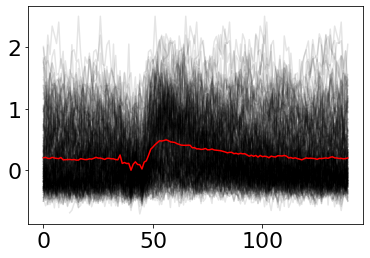

array([ 583.37980721,  531.09735665,  525.01839561, ..., 1003.11377314,
       1001.70446318, 1013.26529298])

/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 0, 'Change in mean of movement')

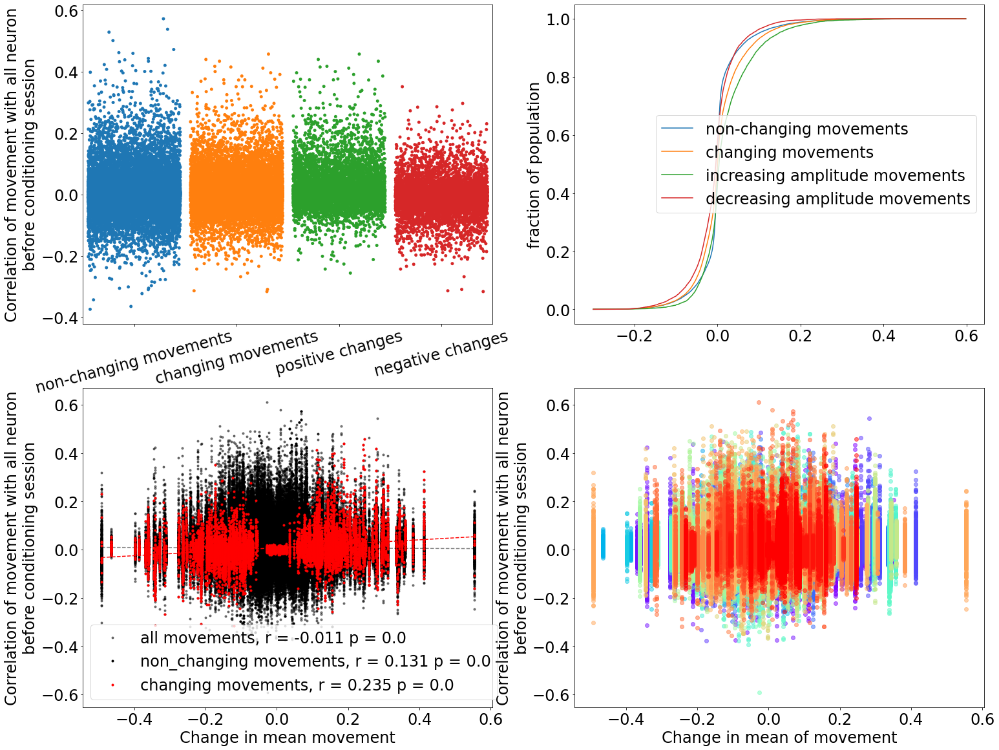

In [52]:
import seaborn as sns
import matplotlib as mpl
from matplotlib import cm
max_p_for_movements = .05
max_p_for_correlation_with_movements = 1.01
min_p_for_nonchangin_movements = .1
significantly_correlated_before_conditioning_day = np.concatenate(corr_p_with_cn_before_conditioning_day_all)<=max_p_for_correlation_with_movements
delta_tuning_restriction =( np.concatenate(delta_tuning_all)>0.1)# & ( np.concatenate(previous_tuning_all)<0) #delta_tuning_all#previous_tuning_all



changing_indices =(np.concatenate(p_change_all)<=max_p_for_movements) & significantly_correlated_before_conditioning_day &delta_tuning_restriction
increasing_indices = (np.concatenate(p_increase_all)<=max_p_for_movements) & significantly_correlated_before_conditioning_day &delta_tuning_restriction
decreasing_indices = (np.concatenate(p_decrease_all)<=max_p_for_movements) & significantly_correlated_before_conditioning_day &delta_tuning_restriction
non_changing_indices = (np.concatenate(p_change_all)>=min_p_for_nonchangin_movements) & significantly_correlated_before_conditioning_day &delta_tuning_restriction
x_values = np.concatenate([['non-changing movements']*sum(non_changing_indices),
                         ['changing movements']*sum(changing_indices),
                         ['positive changes']*sum(increasing_indices),
                         ['negative changes']*sum(decreasing_indices)])
# colors = np.concatenate([['k']*sum(non_changing_indices),
#                          ['g']*sum(changing_indices),
#                          ['r']*sum(increasing_indices),
#                          ['b']*sum(decreasing_indices)])
y_values = np.concatenate([np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices],
                           np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices],
                           np.concatenate(corr_with_cn_before_conditioning_day_all)[increasing_indices],
                           np.concatenate(corr_with_cn_before_conditioning_day_all)[decreasing_indices]])
fig = plt.figure(figsize = [25,20])
ax1 = fig.add_subplot(2,2,1)
sns.stripplot(x_values,y_values,ax=ax1,size = 5,alpha = 1,jitter = .45)#, color = colors)
ax1.set_ylabel('Correlation of movement with {} neuron\nbefore conditioning session'.format(cells_to_look_at))
ax1.set_xticklabels(ax1.get_xticklabels(), rotation = 15)
ax2 = fig.add_subplot(2,2,2)
xbins = np.arange(-.3,.6,.001)
y_nonchanging,x = np.histogram(np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices],xbins)
y_changing,x = np.histogram(np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices],xbins)
y_increasing,x = np.histogram(np.concatenate(corr_with_cn_before_conditioning_day_all)[increasing_indices],xbins)
y_decreasing,x = np.histogram(np.concatenate(corr_with_cn_before_conditioning_day_all)[decreasing_indices],xbins)

xbins = np.nanmean([xbins[1:],xbins[:-1]],0)

ax2.plot(xbins,np.cumsum(y_nonchanging)/sum(y_nonchanging),label = 'non-changing movements')
ax2.plot(xbins,np.cumsum(y_changing)/sum(y_changing),label = 'changing movements')
ax2.plot(xbins,np.cumsum(y_increasing)/sum(y_increasing),label = 'increasing amplitude movements')
ax2.plot(xbins,np.cumsum(y_decreasing)/sum(y_decreasing),label = 'decreasing amplitude movements')


ax2.set_ylabel('Correlation of movement with {} neuron\nbefore conditioning session'.format(cells_to_look_at))
ax2.set_ylabel('fraction of population')
ax2.legend()


ax3 = fig.add_subplot(2,2,3)

r,t= scipy.stats.pearsonr(np.concatenate(movement_amplitude_change_list_all)[significantly_correlated_before_conditioning_day],np.concatenate(corr_with_cn_before_conditioning_day_all)[significantly_correlated_before_conditioning_day])
ax3.plot(np.concatenate(movement_amplitude_change_list_all)[significantly_correlated_before_conditioning_day],np.concatenate(corr_with_cn_before_conditioning_day_all)[significantly_correlated_before_conditioning_day],'k.',alpha = .5,label = 'all movements, r = {} p = {}'.format(np.round(r,3),np.round(t,3)))
p = np.polyfit(np.concatenate(movement_amplitude_change_list_all)[significantly_correlated_before_conditioning_day],np.concatenate(corr_with_cn_before_conditioning_day_all)[significantly_correlated_before_conditioning_day],1)
xvals = np.percentile(np.concatenate(movement_amplitude_change_list_all),[0,100])
yvals = np.polyval(p,xvals)
ax3.plot(xvals,yvals,'k--',alpha = .5)


r,t= scipy.stats.pearsonr(np.concatenate(movement_amplitude_change_list_all)[non_changing_indices],np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices])
ax3.plot(np.concatenate(movement_amplitude_change_list_all)[non_changing_indices],np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices],'k.',alpha = 1,label = 'non_changing movements, r = {} p = {}'.format(np.round(r,3),np.round(t,3)))
p = np.polyfit(np.concatenate(movement_amplitude_change_list_all)[non_changing_indices],np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices],1)
xvals = np.percentile(np.concatenate(movement_amplitude_change_list_all)[non_changing_indices],[0,100])
yvals = np.polyval(p,xvals)
ax3.plot(xvals,yvals,'k--')


r,t= scipy.stats.pearsonr(np.concatenate(movement_amplitude_change_list_all)[changing_indices],np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices])
ax3.plot(np.concatenate(movement_amplitude_change_list_all)[changing_indices],np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices],'r.',alpha = 1,label = 'changing movements, r = {} p = {}'.format(np.round(r,3),np.round(t,3)))

p = np.polyfit(np.concatenate(movement_amplitude_change_list_all)[changing_indices],np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices],1)
xvals = np.percentile(np.concatenate(movement_amplitude_change_list_all)[changing_indices],[0,100])
yvals = np.polyval(p,xvals)
ax3.plot(xvals,yvals,'r--')



ax3.set_ylabel('Correlation of movement with {} neuron\nbefore conditioning session'.format(cells_to_look_at))
ax3.set_xlabel('Change in {} movement'.format(change_of_what))
ax3.legend()
cmap = cm.get_cmap('rainbow', len(movement_amplitude_change_list_all))    # 11 discrete colors

ax4 = fig.add_subplot(2,2,4)
for i,(x,y) in enumerate(zip(movement_amplitude_change_list_all,corr_with_cn_before_conditioning_day_all)):
    ax4.plot(x,y,'o',label = 'session {}'.format(i),color = cmap(i),alpha = .5)
ax4.set_ylabel('Correlation of movement with {} neuron\nbefore conditioning session'.format(cells_to_look_at))
ax4.set_xlabel('Change in {} of movement'.format(change_of_what))
#ax4.legend()


/tmp/ipykernel_25117/3909344523.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = [10,10])
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


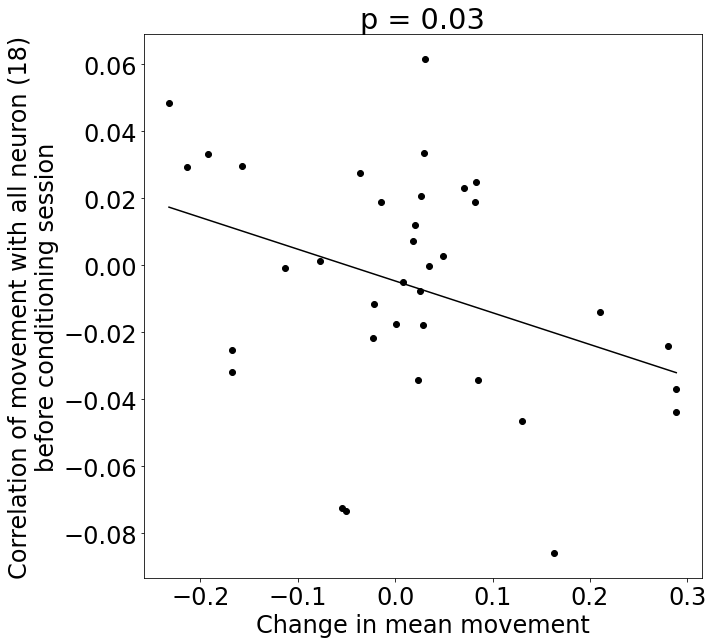

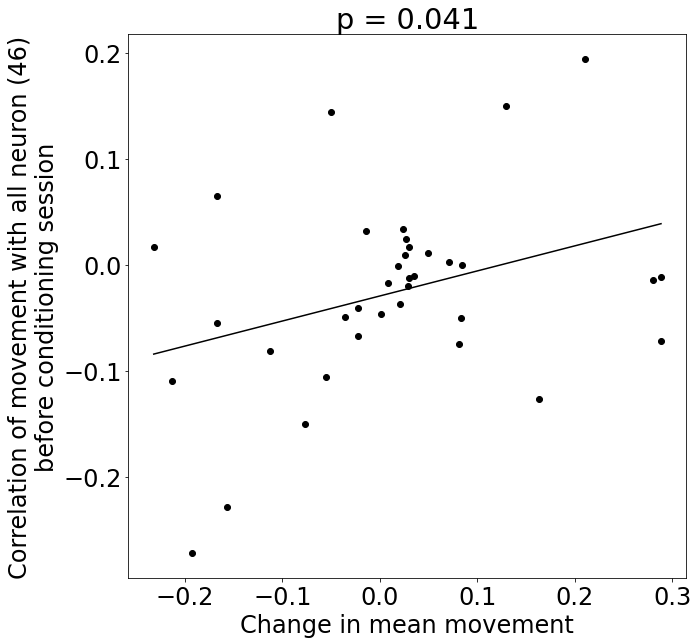

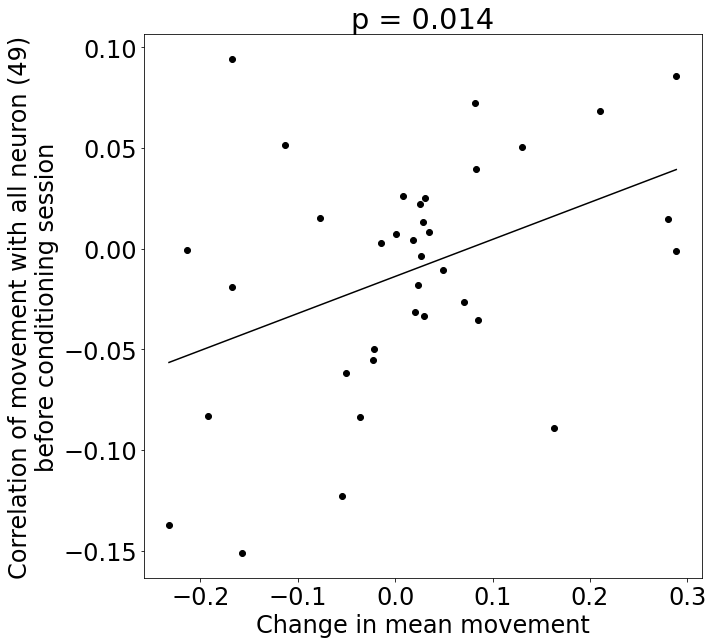

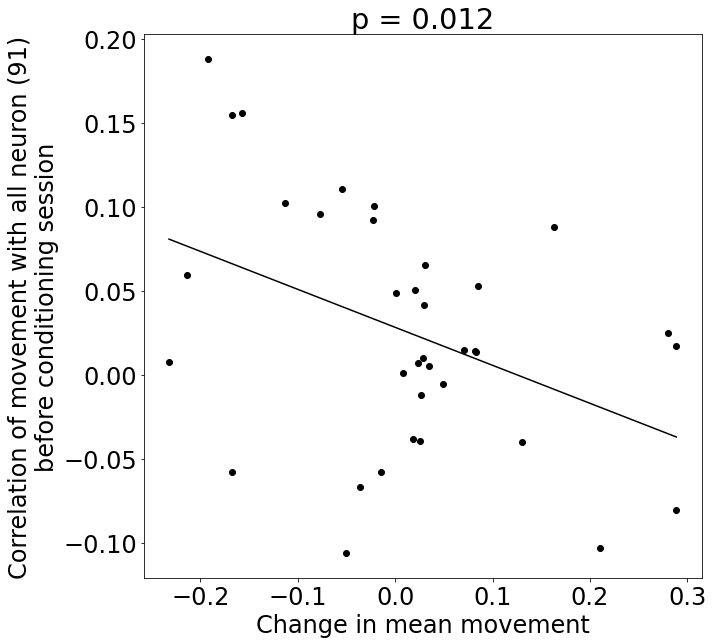

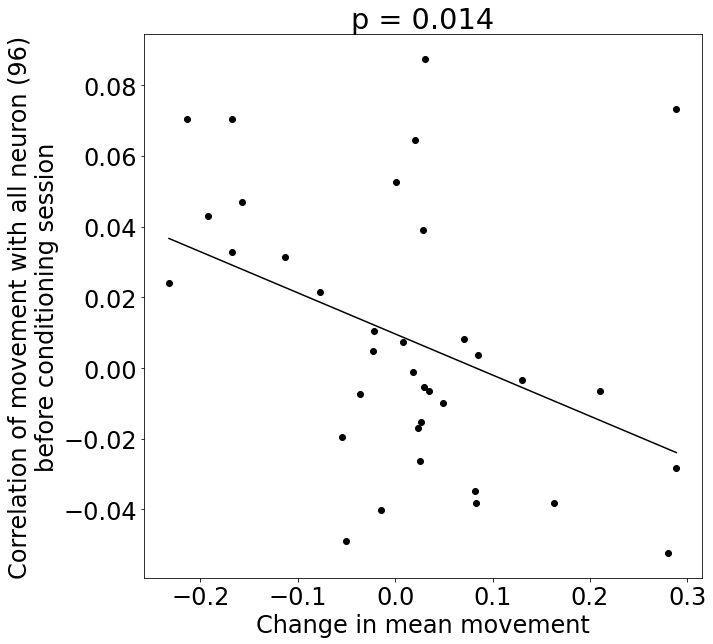

...

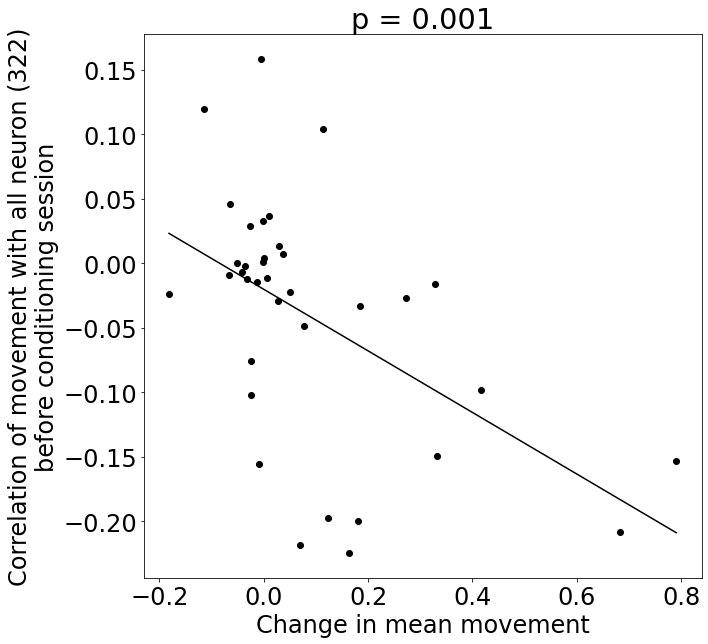

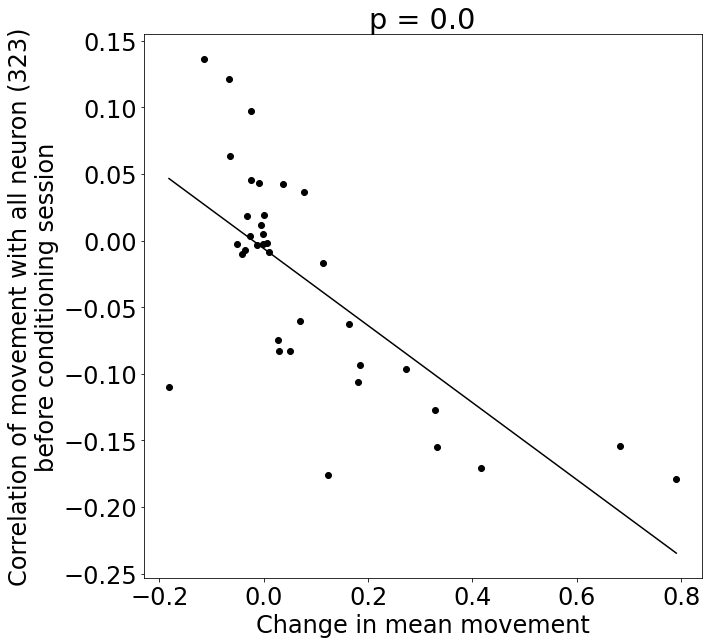

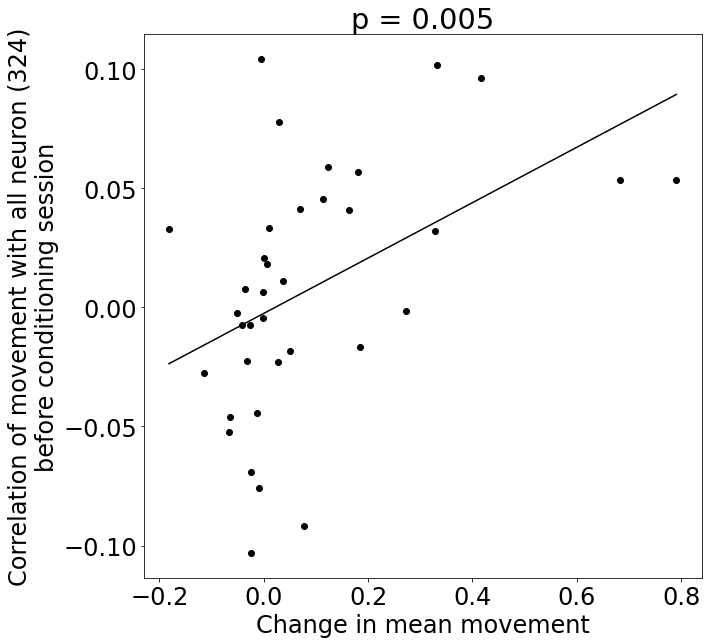

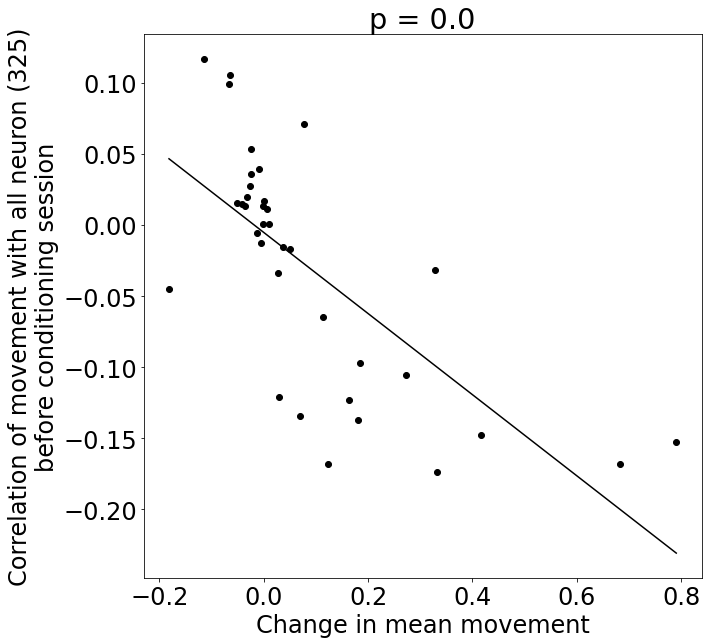

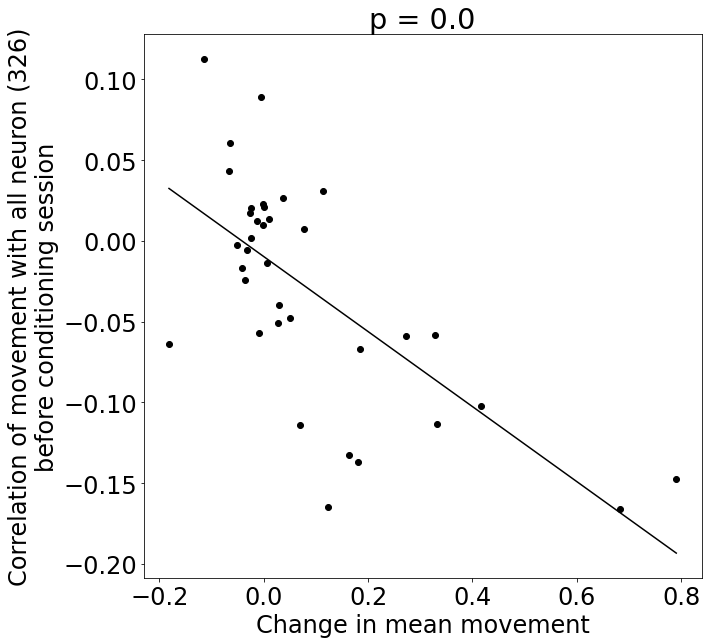

Error in callback <function flush_figures at 0x7f0153f02ee0> (for post_execute):


KeyboardInterrupt: 

In [47]:
p_list = []
for session_i in range(len(movement_amplitude_change_list_all)):
    cell_id_list = np.unique(cell_id_list_all[session_i])
    for cell_id in cell_id_list:
        indices = cell_id_list_all[session_i] == cell_id
        movement_amplitudes = movement_amplitude_change_list_all[session_i][indices]
        corrcoefs = corr_with_cn_before_conditioning_day_all[session_i][indices]
        r,p= scipy.stats.pearsonr(movement_amplitudes,corrcoefs)
        p_list.append(p)
        if p<.05:
            fig = plt.figure(figsize = [10,10])
            plt.plot(movement_amplitudes,corrcoefs,'ko')
            plt.title('p = {}'.format(np.round(p,3)))
            plt.ylabel('Correlation of movement with {} neuron ({})\nbefore conditioning session'.format(cells_to_look_at,cell_id))
            plt.xlabel('Change in {} movement'.format(change_of_what))
            pp = np.polyfit(movement_amplitudes,corrcoefs,1)
            xs = np.percentile(movement_amplitudes,[0,100])
            ys = np.polyval(pp,xs)
            plt.plot(xs,ys,'k-')

(array([  156.,   622.,   622.,     0.,   716.,     0.,     0.,     0.,
          364.,   156.,     0.,   716.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,  1080.,  1960.,   364.,   364.,   622.,
          872.,   728.,  2324.,   716.,  1142.,  1080.,  1858.,  3146.,
         3822.,  2636.,  3622.,  4964.,  6050., 11208.,  9040., 11736.,
         9880., 19760., 20484., 14272., 15836., 14426.,  5780.,  8624.,
         7066.,  9686.,  2742.,  5352.,  3310.,  1080.,  1714.,  3404.,
         1650.,   622.,   986.,   364.,     0.,     0.,     0.,   716.,
            0.,     0.,     0.,   156.,     0.,     0.,     0.,   716.,
          156.,     0.,     0.,     0.,     0.,     0.,   716.,   716.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,   156.]),
 array([-1.55963436e+00, -1.52254737e+00, -1.48546038e+00, -1.44837340e+00,
        -1.4112864

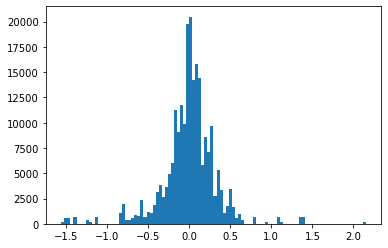

In [72]:
plt.hist(np.concatenate(movement_amplitude_change_list_all),100)

In [53]:
y,x = np.histogram(p_list,np.arange(0,1,.001))
x=np.nanmean([x[1:],x[:-1]],0)
fig = plt.figure(figsize = [16,10])
plt.plot(x,np.cumsum(y)/sum(y),'k-')
plt.vlines(.05,0,1,color = 'red')
plt.title('{} cells out of {}, - {}%'.format(sum(np.asarray(p_list)<.05),len(p_list),np.round(100*sum(np.asarray(p_list)<.05)/len(p_list),1)))
plt.xlabel('p correlation')
plt.ylabel('proportion of cells')

NameError: name 'p_list' is not defined

In [ ]:
# hierarchical bootstrapping of data
n_bootstrap = 10000
slope_list = []
pearson_r_list = []
pearson_p_list = []
for bootstrap_i in range(n_bootstrap):
    session_indices = resample(np.arange(len(movement_amplitude_change_list_all)))
    movement_amplitudes = np.concatenate(np.asarray(movement_amplitude_change_list_all)[session_indices])
    corrcoefs = np.concatenate(np.asarray(corr_with_cn_before_conditioning_day_all)[session_indices])#
    indices = resample(np.arange(len(movement_amplitudes)))
    movement_amplitudes = movement_amplitudes[indices]
    corrcoefs = corrcoefs[indices]
    p = np.polyfit(movement_amplitudes,corrcoefs,1)
    slope_list.append(p[0])
    r,p= scipy.stats.pearsonr(movement_amplitudes,corrcoefs)
    pearson_r_list.append(r)
    pearson_p_list.append(p)

/tmp/ipykernel_25117/1873665014.py:8: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  movement_amplitudes = np.concatenate(np.asarray(movement_amplitude_change_list_all)[session_indices])
/tmp/ipykernel_25117/1873665014.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrcoefs = np.concatenate(np.asarray(corr_with_cn_before_conditioning_day_all)[session_indices])#


In [ ]:
for session_i in range(len(movement_amplitude_change_list_all)):
    movement_amplitudes = np.asarray(movement_amplitude_change_list_all)[session_i]
    corrcoefs = np.asarray(corr_with_cn_before_conditioning_day_all)[session_i]
    r,p= scipy.stats.pearsonr(movement_amplitudes,corrcoefs)
    if p<.05:
        plt.figure()
        plt.plot(movement_amplitudes,corrcoefs,'k.')
        plt.title('sessoion {}, r = {}'.format(session_i,np.round(r,3)))

In [ ]:
fig = plt.figure(figsize = [15,15])
ax1 = fig.add_subplot(2,2,1)
ax1.hist(slope_list,100)
ax1.set_title('slope : p = {}'.format(np.sum(np.asarray(slope_list)<0)/len(slope_list)))
ax2 = fig.add_subplot(2,2,2)
ax2.hist(pearson_r_list,100)
ax2.set_title('Pearson R : p = {}'.format(np.sum(np.asarray(pearson_r_list)<0)/len(pearson_r_list)))


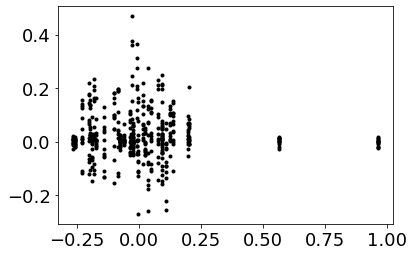

In [92]:
plt.plot(movement_amplitudes,corrcoefs,'k.')

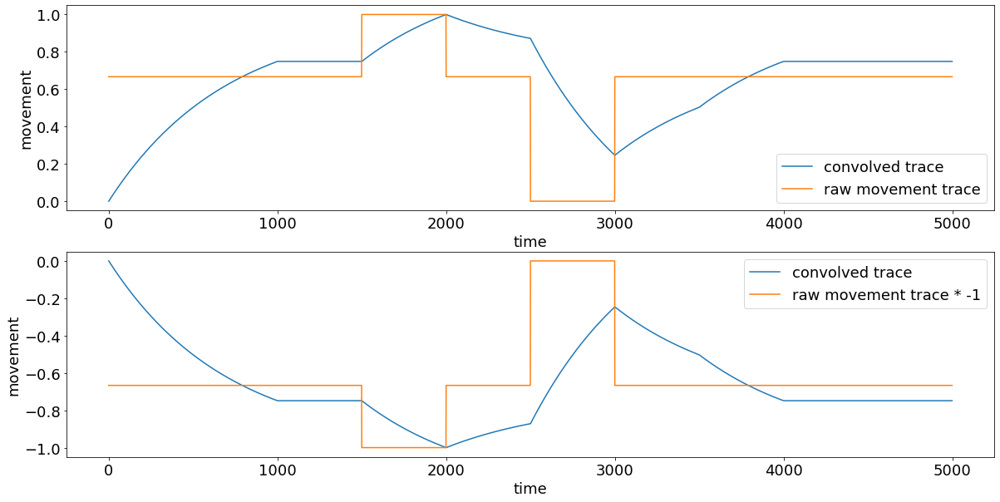

In [93]:
convolve_tau  =.7
amplitude =1
sample_interval = .001
calcium_transient_t = np.arange(0,1,sample_interval)# ms 
decay = np.exp(calcium_transient_t/-convolve_tau)
calcium_transient = decay #rise*decay
calcium_transient = amplitude*calcium_transient/np.max(calcium_transient)
calcium_transient = np.concatenate([np.zeros_like(calcium_transient),calcium_transient])
#plt.plot(calcium_transient)#
test_signal = np.zeros(5000)+20

test_signal[1500:2000]+=10
test_signal[2000:2500]+=-0
test_signal[2500:3000]-=20
test_filt = np.convolve(test_signal,calcium_transient,'same')
fig = plt.figure(figsize = [20,10])
ax1 = fig.add_subplot(2,1,1)
plt.plot(test_filt/np.max(np.abs(test_filt)),label = 'convolved trace')
plt.plot(test_signal/np.max(np.abs(test_signal)),label = 'raw movement trace')
#plt.xlim([0,10000])
plt.ylabel('movement')
plt.xlabel('time')
plt.legend()


test_signal = test_signal*-1#+30
test_filt = np.convolve(test_signal,calcium_transient,'same')

ax2 = fig.add_subplot(2,1,2)
ax2.plot(test_filt/np.max(np.abs(test_filt)),label = 'convolved trace')
ax2.plot(test_signal/np.max(np.abs(test_signal)),label = 'raw movement trace * -1')
#ax2.xlim([0,10000])
ax2.set_ylabel('movement')
ax2.set_xlabel('time')
ax2.legend()

Text(0, 0.5, 'cumulative counts')

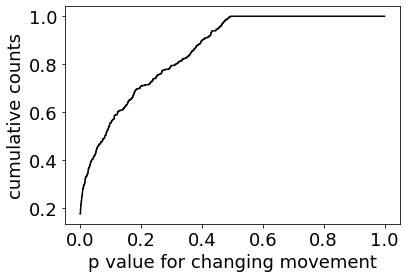

In [256]:
y,x = np.histogram(np.concatenate(p_change_all),np.arange(0,1,.0001))
x = np.nanmean([x[:-1],x[1:]],0)
plt.plot(x,np.cumsum(y)/sum(y),'k-')
plt.xlabel('p value for changing movement')
plt.ylabel('cumulative counts')

In [56]:
import matplotlib
font = {'family' : 'normal',
        #'weight' : 'bold',
        'size'   : 18}

matplotlib.rc('font', **font)


Text(0, 0.5, 'biggest correlation of CN with decreasing movements')

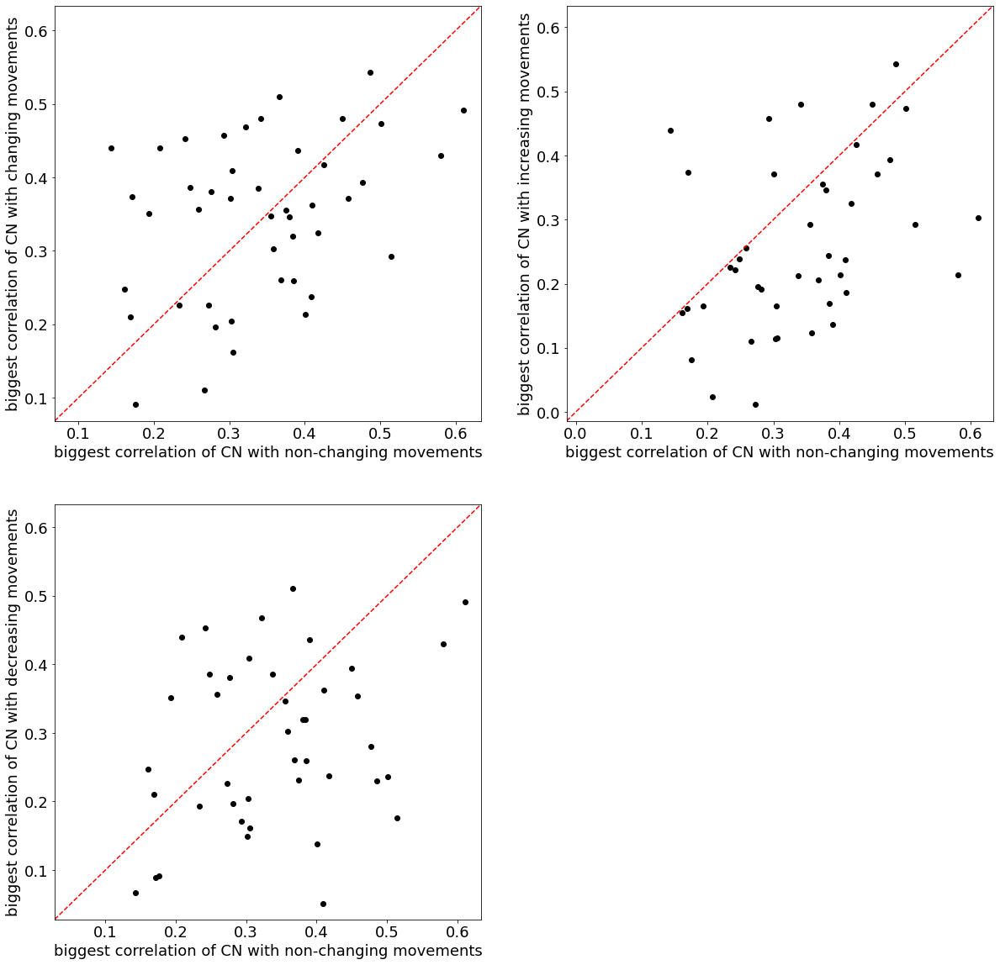

In [101]:
max_p_for_changing_movements = 0.05
min_p_for_non_changing_movements = .3

max_ccs_all = []
max_ccs_changing_movements=  []
max_ccs_nonchanging_movements=  []
max_ccs_decreasing_movements=  []
max_ccs_increasing_movements=  []
for session_i in np.arange(len(corr_with_cn_before_conditioning_day_all)):
    max_idx = np.argmax(np.abs(corr_with_cn_before_conditioning_day_all[session_i]))
    max_val = corr_with_cn_before_conditioning_day_all[session_i][max_idx]
    max_ccs_all.append(max_val)
    
    
    changing_indices = p_change_all[session_i] <=max_p_for_changing_movements
    if sum(changing_indices)==0:
        max_ccs_changing_movements.append(np.nan)
        # continue
        # changing_indices = np.ones(len(p_decrease_all[session_i]))==2
        # changing_indices[np.argmin(p_decrease_all[session_i])] = True
    else:
        max_idx = np.argmax(corr_with_cn_before_conditioning_day_all[session_i][changing_indices])
        max_ccs_changing_movements.append(corr_with_cn_before_conditioning_day_all[session_i][changing_indices][max_idx])
        
        
    changing_indices = p_decrease_all[session_i] <=max_p_for_changing_movements
    if sum(changing_indices)==0:
        max_ccs_decreasing_movements.append(np.nan)
        # continue
        # changing_indices = np.ones(len(p_decrease_all[session_i]))==2
        # changing_indices[np.argmin(p_decrease_all[session_i])] = True
    else:
        max_idx = np.argmax(corr_with_cn_before_conditioning_day_all[session_i][changing_indices])
        max_ccs_decreasing_movements.append(corr_with_cn_before_conditioning_day_all[session_i][changing_indices][max_idx])
    changing_indices = p_increase_all[session_i] <=max_p_for_changing_movements
    if sum(changing_indices)==0:
        max_ccs_increasing_movements.append(np.nan)
        # continue
        # changing_indices = np.ones(len(p_decrease_all[session_i]))==2
        # changing_indices[np.argmin(p_decrease_all[session_i])] = True
    else:
        max_idx = np.argmax(corr_with_cn_before_conditioning_day_all[session_i][changing_indices])
        max_ccs_increasing_movements.append(corr_with_cn_before_conditioning_day_all[session_i][changing_indices][max_idx])
    
    nonchanging_indices = p_change_all[session_i] >min_p_for_non_changing_movements
    max_idx = np.argmax(corr_with_cn_before_conditioning_day_all[session_i][nonchanging_indices])
    max_ccs_nonchanging_movements.append(corr_with_cn_before_conditioning_day_all[session_i][nonchanging_indices][max_idx])
fig = plt.figure(figsize = [20,20])
ax = fig.add_subplot(2,2,1)
ax.plot(max_ccs_nonchanging_movements,max_ccs_changing_movements,'ko')
limits = np.concatenate([ax.get_xlim(),ax.get_ylim()])
limits = [np.nanmin(limits),np.nanmax(limits)]
ax.plot(limits,limits,'r--')
ax.set_xlim(limits)
ax.set_ylim(limits)
ax.set_xlabel('biggest correlation of CN with non-changing movements')
ax.set_ylabel('biggest correlation of CN with changing movements')


ax = fig.add_subplot(2,2,2)
ax.plot(max_ccs_nonchanging_movements,max_ccs_increasing_movements,'ko')
limits = np.concatenate([ax.get_xlim(),ax.get_ylim()])
limits = [np.nanmin(limits),np.nanmax(limits)]
ax.plot(limits,limits,'r--')
ax.set_xlim(limits)
ax.set_ylim(limits)
ax.set_xlabel('biggest correlation of CN with non-changing movements')
ax.set_ylabel('biggest correlation of CN with increasing movements')

ax = fig.add_subplot(2,2,3)
ax.plot(max_ccs_nonchanging_movements,max_ccs_decreasing_movements,'ko')
limits = np.concatenate([ax.get_xlim(),ax.get_ylim()])
limits = [np.nanmin(limits),np.nanmax(limits)]
ax.plot(limits,limits,'r--')
ax.set_xlim(limits)
ax.set_ylim(limits)
ax.set_xlabel('biggest correlation of CN with non-changing movements')
ax.set_ylabel('biggest correlation of CN with decreasing movements')
# ax.hist(max_ccs_all,alpha = .5)
# ax.hist(max_ccs_changing_movements,alpha = .5)

In [155]:
max_val

-0.17966191385642127

In [76]:
sum(y)

0.9999999999999969

In [78]:
x

array([-5.0000000e-01, -4.9000000e-01, -4.8000000e-01, -4.7000000e-01,
       -4.6000000e-01, -4.5000000e-01, -4.4000000e-01, -4.3000000e-01,
       -4.2000000e-01, -4.1000000e-01, -4.0000000e-01, -3.9000000e-01,
       -3.8000000e-01, -3.7000000e-01, -3.6000000e-01, -3.5000000e-01,
       -3.4000000e-01, -3.3000000e-01, -3.2000000e-01, -3.1000000e-01,
       -3.0000000e-01, -2.9000000e-01, -2.8000000e-01, -2.7000000e-01,
       -2.6000000e-01, -2.5000000e-01, -2.4000000e-01, -2.3000000e-01,
       -2.2000000e-01, -2.1000000e-01, -2.0000000e-01, -1.9000000e-01,
       -1.8000000e-01, -1.7000000e-01, -1.6000000e-01, -1.5000000e-01,
       -1.4000000e-01, -1.3000000e-01, -1.2000000e-01, -1.1000000e-01,
       -1.0000000e-01, -9.0000000e-02, -8.0000000e-02, -7.0000000e-02,
       -6.0000000e-02, -5.0000000e-02, -4.0000000e-02, -3.0000000e-02,
       -2.0000000e-02, -1.0000000e-02,  4.4408921e-16,  1.0000000e-02,
        2.0000000e-02,  3.0000000e-02,  4.0000000e-02,  5.0000000e-02,
      

'a'

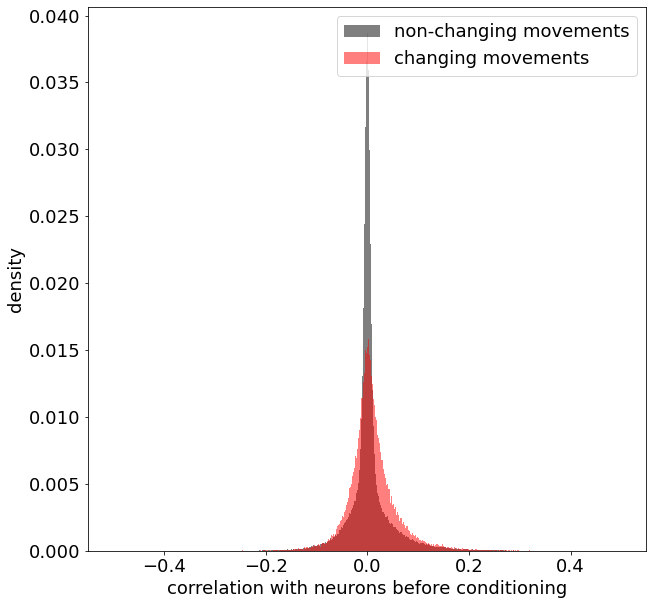

In [98]:
is_it_cn = np.concatenate(is_it_CN_all)
changing_indices = np.concatenate(p_change_all)<=0.01
non_changing_indices = np.concatenate(p_change_all)>=0.2

fig = plt.figure(figsize = [10,10])
bins = np.arange(-.5,.5,.001)
ax = fig.add_subplot(111)
y,x = np.histogram(np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices],bins)
y = y/sum(y)
y_changing,x_changing = np.histogram(np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices],bins)
y_changing = y_changing/sum(y_changing)
x = x[:-1]
ax.bar(x,y,width=0.001,alpha = .5, color = 'black',label = 'non-changing movements')
ax.bar(x,y_changing,width=0.001,alpha = .5, color = 'red',label = 'changing movements')
ax.set_xlabel('correlation with neurons before conditioning')
ax.legend()
ax.set_ylabel('density')
#plt.hist(,alpha = .5, color = 'red')
'a'

/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'Correlation with CN before conditioning session')

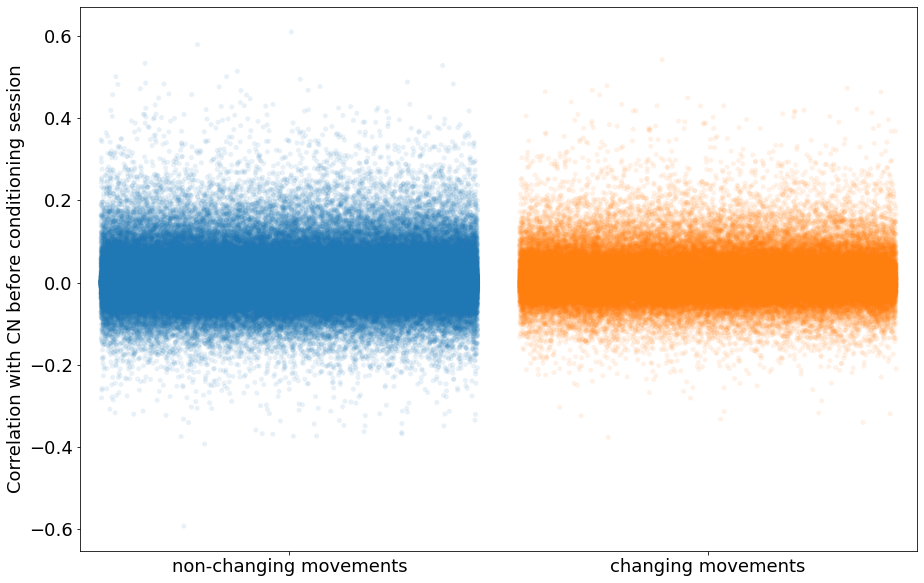

In [63]:
import seaborn as sns
changing_indices = np.concatenate(p_change_all)<=0.01
non_changing_indices = np.concatenate(p_change_all)>=0.2
x_values = np.concatenate([['non-changing movements']*sum(non_changing_indices),
                         ['changing movements']*sum(changing_indices)])
y_values = np.concatenate([np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices],
                           np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices]])
fig = plt.figure(figsize = [15,10])
ax1 = fig.add_subplot(1,1,1)
sns.stripplot(x_values,y_values,ax=ax1,size = 5,alpha = .1,jitter = .45)#swarmplot
ax1.set_ylabel('Correlation with CN before conditioning session')




/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


KeyboardInterrupt: 

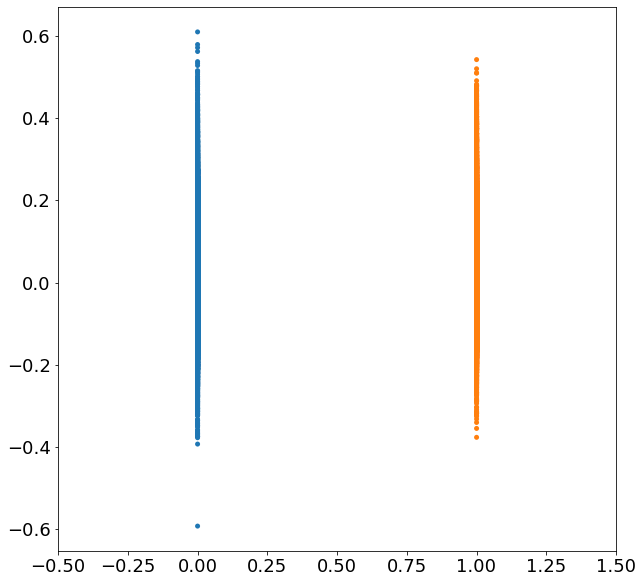

In [99]:
import seaborn as sns
changing_indices = np.concatenate(p_change_all)<=0.1
non_changing_indices = np.concatenate(p_change_all)>=0.1
x_values = np.concatenate([['non-changing movements']*sum(non_changing_indices),
                         ['changing movements']*sum(changing_indices)])
y_values = np.concatenate([np.concatenate(corr_with_cn_before_conditioning_day_all)[non_changing_indices],
                           np.concatenate(corr_with_cn_before_conditioning_day_all)[changing_indices]])
fig = plt.figure(figsize = [10,10])
ax1 = fig.add_subplot(1,1,1)
sns.swarmplot(x_values,y_values,ax=ax1)


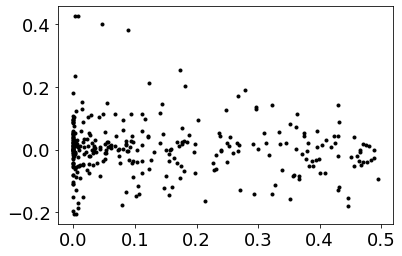

In [158]:
plt.plot(np.concatenate(p_change_all),np.concatenate(corr_with_cn_before_conditioning_day_all),'k.')

In [159]:
np.min(p_increase_list)

0.0020000000000000018

(array([2., 2., 1., 0., 4., 2., 3., 3., 3., 4.]),
 array([0.    , 0.0998, 0.1996, 0.2994, 0.3992, 0.499 , 0.5988, 0.6986,
        0.7984, 0.8982, 0.998 ]),
 <BarContainer object of 10 artists>)

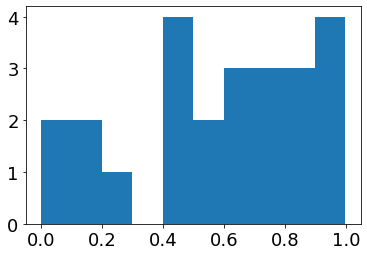

In [160]:
plt.hist(p_decrease_list)